In [1]:
import sys
import os
from glob import glob
sys.path.append("../NEAT")
from NEATModels import NEATStatic, nets
from NEATModels.Staticconfig  import static_config
from NEATUtils import helpers
from NEATUtils.helpers import save_json, load_json
os.environ["CUDA_VISIBLE_DEVICES"]="0"
os.environ["HDF5_USE_FILE_LOCKING"] = "FALSE"

Using TensorFlow backend.


In [2]:
npz_directory = '/home/sancere/Kepler/CurieTrainingDatasets/Dalmiro_Laura/LandmarkData/'
npz_name = 'Landmark128.npz'
npz_val_name = 'Landmark128Val.npz'


model_dir = '/home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/'
#Model name based on wether it is residual or sequntial ONEAT network
model_name = 'Landmark128.h5'


In [3]:
static_categories_json = model_dir + 'StaticCategories.json'
key_categories = load_json(static_categories_json)
static_cord_json = model_dir + 'StaticCord.json'
key_cord = load_json(static_cord_json)

#For ORNET use residual = True and for OSNET use residual = False
residual = False
#NUmber of starting convolutional filters, is doubled down with increasing depth
startfilter = 48
#CNN network start layer, mid layers and lstm layer kernel size
start_kernel = 7
mid_kernel = 3
#Network depth has to be 9n + 2, n= 3 or 4 is optimal for Notum dataset
depth = 29
#Size of the gradient descent length vector, start small and use callbacks to get smaller when reaching the minima
learning_rate = 1.0E-6
#For stochastic gradient decent, the batch size used for computing the gradients
batch_size = 10
# use softmax for single event per box, sigmoid for multi event per box
multievent = False
# Trainng image size
yolo_v0 = True
show = True
#Training epochs, longer the better with proper chosen learning rate
epochs = 250
nboxes = 1
#The inbuilt model stride which is equal to the nulber of times image was downsampled by the network
stride = 4
show = True
imagex = 128
imagey = 128

In [4]:
config = static_config(npz_directory =npz_directory, npz_name = npz_name, npz_val_name = npz_val_name, 
                         key_categories = key_categories, key_cord = key_cord, 
                         residual = residual, depth = depth, start_kernel = start_kernel, stride = stride, mid_kernel = mid_kernel,
                         startfiler = startfilter, nboxes = nboxes, gridx = 1, gridy = 1, show = show,
                         epochs = epochs, learning_rate = learning_rate, imagex = imagex, imagey = imagey,
                         batch_size = batch_size, model_name = model_name, yolo_v0 = yolo_v0, multievent = multievent)

config_json = config.to_json()

print(config)
save_json(config_json, model_dir + os.path.splitext(model_name)[0] + '_Parameter.json')

static_config(batch_size=10, box_vector=2, categories=2, depth=29, epochs=250, gridx=1, gridy=1, imagex=128, imagey=128, key_categories={'Background': 0, 'Landmark': 1}, key_cord={'x': 0, 'y': 1}, learning_rate=1e-06, mid_kernel=3, model_name='Landmark128.h5', multievent=False, nboxes=1, npz_directory='/home/sancere/Kepler/CurieTrainingDatasets/Dalmiro_Laura/LandmarkData/', npz_name='Landmark128.npz', npz_val_name='Landmark128Val.npz', residual=False, show=True, start_kernel=7, startfilter=32, stride=(4,), yolo_v0=True)


number of  images:	 2656
image size (2D):		 (128, 128)
axes:				 SXYC
channels in / out:		 1
number of  images:	 140
image size (2D):		 (128, 128)
axes:				 SXYC
channels in / out:		 1
(2656, 1, 1, 4) 1
Instructions for updating:
If using Keras pass *_constraint arguments to layers.
Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, None, None, 1 0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, None, None, 3 1600        input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, None, None, 3 128         conv2d_1[0][0]                   
______


Train on 2656 samples, validate on 140 samples
Epoch 1/250
2656/2656 [==============================] - 19s 7ms/step - loss: 0.7388 - accuracy: 0.7703 - val_loss: 0.6894 - val_accuracy: 0.8357

Epoch 00001: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.6893510861056191, 'val_accuracy': 0.8357142806053162, 'loss': 0.7387926869588085, 'accuracy': 0.7703313, 'lr': 1e-06}


<Figure size 432x288 with 0 Axes>

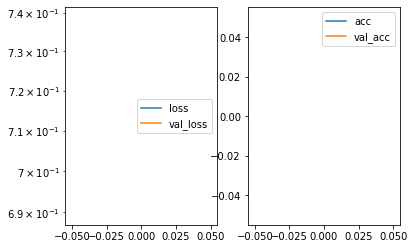

Predicted cell: Landmark Probability: [[0.74408]]
True Cell type: Landmark
x [[0.682786]]
True positional value x 0.5
y [[0.43783757]]
True positional value y 0.578125


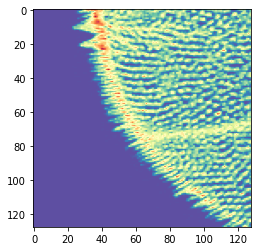

Epoch 2/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.6449 - accuracy: 0.8897 - val_loss: 0.6265 - val_accuracy: 0.8857

Epoch 00002: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.6264852072511401, 'val_accuracy': 0.8857142925262451, 'loss': 0.6449142300624804, 'accuracy': 0.8896837, 'lr': 1e-06}


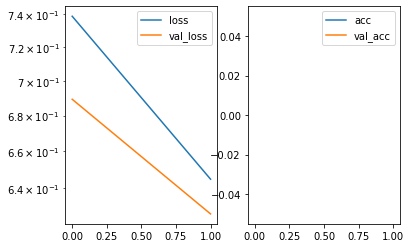

Predicted cell: Landmark Probability: [[0.85094386]]
True Cell type: Landmark
x [[0.6830082]]
True positional value x 0.5781249999999998
y [[0.7340272]]
True positional value y 0.421875


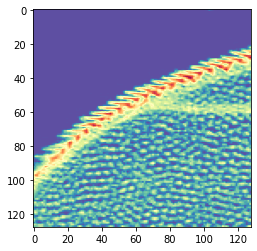

Epoch 3/250
2656/2656 [==============================] - 12s 5ms/step - loss: 0.6130 - accuracy: 0.8893 - val_loss: 0.6252 - val_accuracy: 0.8857

Epoch 00003: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.6252153664827347, 'val_accuracy': 0.8857142925262451, 'loss': 0.6130103280386293, 'accuracy': 0.8893072, 'lr': 1e-06}


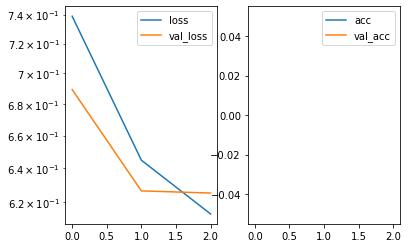

Predicted cell: Landmark Probability: [[0.9295775]]
True Cell type: Landmark
x [[0.54391927]]
True positional value x 0.578125
y [[0.42093918]]
True positional value y 0.421875


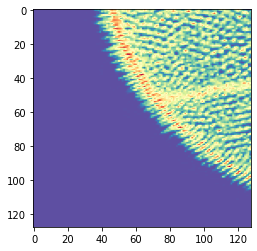

Epoch 4/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.5985 - accuracy: 0.8916 - val_loss: 0.6260 - val_accuracy: 0.8786

Epoch 00004: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.6259972623416356, 'val_accuracy': 0.8785714507102966, 'loss': 0.5984548802925161, 'accuracy': 0.8915663, 'lr': 1e-06}


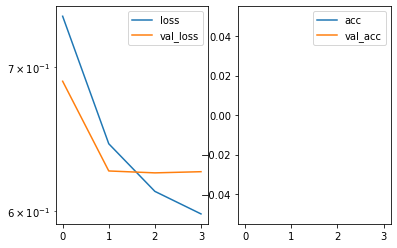

Predicted cell: Landmark Probability: [[0.9401851]]
True Cell type: Landmark
x [[0.68434435]]
True positional value x 0.578125
y [[0.66164654]]
True positional value y 0.5


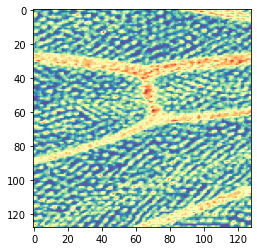

Epoch 5/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.5836 - accuracy: 0.8953 - val_loss: 0.6230 - val_accuracy: 0.8786

Epoch 00005: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.6229916108506066, 'val_accuracy': 0.8785714507102966, 'loss': 0.5836177855640291, 'accuracy': 0.8953313, 'lr': 1e-06}


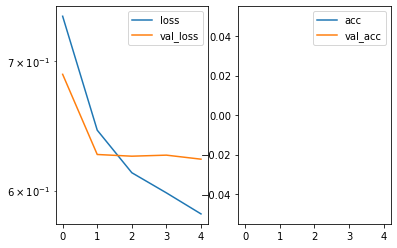

Predicted cell: Landmark Probability: [[0.9477369]]
True Cell type: Landmark
x [[0.23295376]]
True positional value x 0.421875
y [[0.7091747]]
True positional value y 0.5


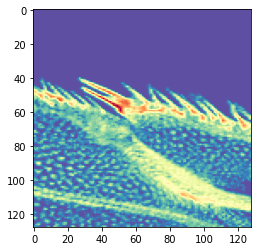

Epoch 6/250
2656/2656 [==============================] - 13s 5ms/step - loss: 0.5752 - accuracy: 0.8953 - val_loss: 0.6197 - val_accuracy: 0.8857

Epoch 00006: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.619699490921838, 'val_accuracy': 0.8857142925262451, 'loss': 0.5752029994121158, 'accuracy': 0.8953313, 'lr': 1e-06}


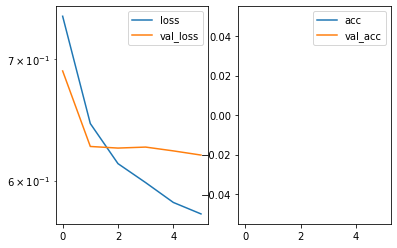

Predicted cell: Landmark Probability: [[0.80255634]]
True Cell type: Background
x [[0.41626558]]
True positional value x 0.5
y [[0.40320417]]
True positional value y 0.5


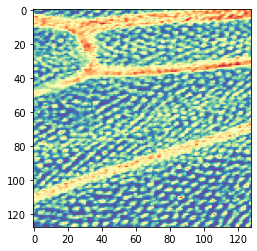

Epoch 7/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.5630 - accuracy: 0.8965 - val_loss: 0.6194 - val_accuracy: 0.8786

Epoch 00007: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.6194402724504471, 'val_accuracy': 0.8785714507102966, 'loss': 0.5629863386906414, 'accuracy': 0.89646083, 'lr': 1e-06}


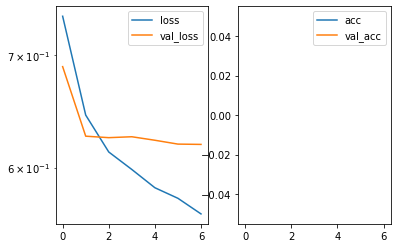

Predicted cell: Landmark Probability: [[0.8880745]]
True Cell type: Landmark
x [[0.4885355]]
True positional value x 0.578125
y [[0.44598487]]
True positional value y 0.421875


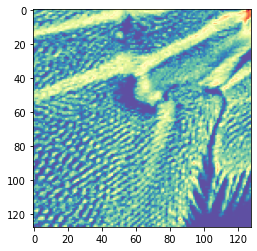

Epoch 8/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.5522 - accuracy: 0.8965 - val_loss: 0.6163 - val_accuracy: 0.8786

Epoch 00008: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.6163186281919479, 'val_accuracy': 0.8785714507102966, 'loss': 0.5522016856191029, 'accuracy': 0.89646083, 'lr': 1e-06}


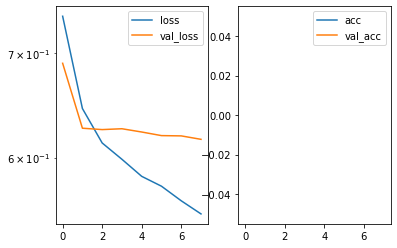

Predicted cell: Landmark Probability: [[0.82974786]]
True Cell type: Landmark
x [[0.31814155]]
True positional value x 0.421875
y [[0.33286956]]
True positional value y 0.578125


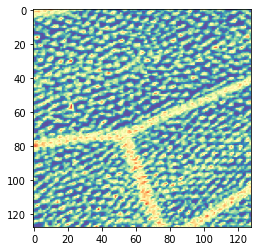

Epoch 9/250
2656/2656 [==============================] - 12s 5ms/step - loss: 0.5397 - accuracy: 0.9002 - val_loss: 0.6129 - val_accuracy: 0.8786

Epoch 00009: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.6129196797098432, 'val_accuracy': 0.8785714507102966, 'loss': 0.5397048455001001, 'accuracy': 0.9002259, 'lr': 1e-06}


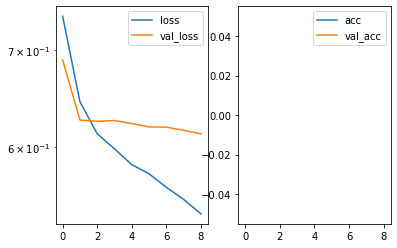

Predicted cell: Landmark Probability: [[0.92905134]]
True Cell type: Landmark
x [[0.28868175]]
True positional value x 0.421875
y [[0.46226397]]
True positional value y 0.5


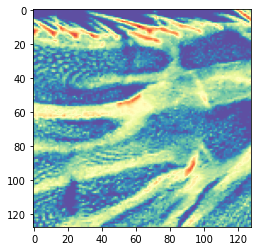

Epoch 10/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.5273 - accuracy: 0.9014 - val_loss: 0.6072 - val_accuracy: 0.8786

Epoch 00010: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.607183215873582, 'val_accuracy': 0.8785714507102966, 'loss': 0.527347330452807, 'accuracy': 0.90135545, 'lr': 1e-06}


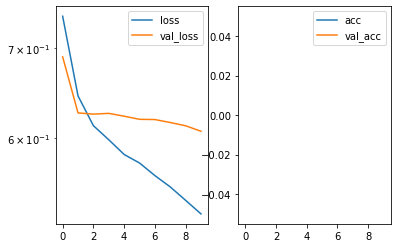

Predicted cell: Landmark Probability: [[0.9518144]]
True Cell type: Landmark
x [[0.59568965]]
True positional value x 0.5
y [[0.5958772]]
True positional value y 0.578125


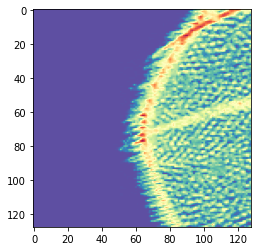

Epoch 11/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.5186 - accuracy: 0.9014 - val_loss: 0.6035 - val_accuracy: 0.8786

Epoch 00011: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.6035269860710416, 'val_accuracy': 0.8785714507102966, 'loss': 0.5186077171644892, 'accuracy': 0.90135545, 'lr': 1e-06}


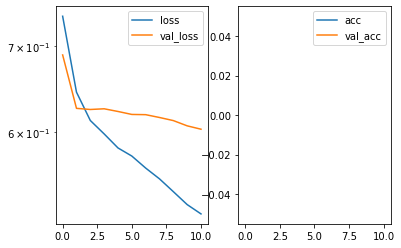

Predicted cell: Landmark Probability: [[0.93197083]]
True Cell type: Landmark
x [[0.58796257]]
True positional value x 0.578125
y [[0.6877232]]
True positional value y 0.578125


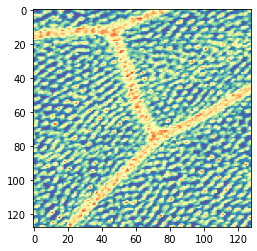

Epoch 12/250
2656/2656 [==============================] - 13s 5ms/step - loss: 0.5078 - accuracy: 0.9021 - val_loss: 0.5989 - val_accuracy: 0.8857

Epoch 00012: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5988770020859582, 'val_accuracy': 0.8857142925262451, 'loss': 0.5077514201851494, 'accuracy': 0.90210843, 'lr': 1e-06}


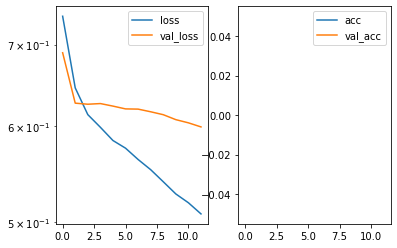

Predicted cell: Landmark Probability: [[0.9643406]]
True Cell type: Landmark
x [[0.64986783]]
True positional value x 0.5
y [[0.43914852]]
True positional value y 0.578125


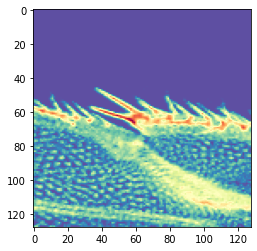

Epoch 13/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.4986 - accuracy: 0.9051 - val_loss: 0.5951 - val_accuracy: 0.8857

Epoch 00013: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5950570915426526, 'val_accuracy': 0.8857142925262451, 'loss': 0.49861043361744967, 'accuracy': 0.9051205, 'lr': 1e-06}


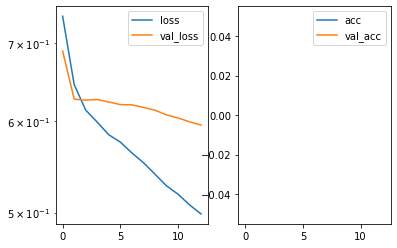

Predicted cell: Landmark Probability: [[0.9602708]]
True Cell type: Landmark
x [[0.505559]]
True positional value x 0.421875
y [[0.5083711]]
True positional value y 0.578125


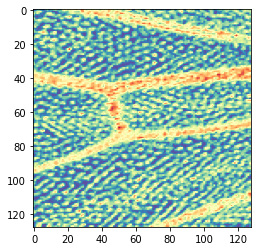

Epoch 14/250
2656/2656 [==============================] - 12s 5ms/step - loss: 0.4867 - accuracy: 0.9062 - val_loss: 0.5899 - val_accuracy: 0.8857

Epoch 00014: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5899303959948676, 'val_accuracy': 0.8857142925262451, 'loss': 0.48666946013199996, 'accuracy': 0.90625, 'lr': 1e-06}


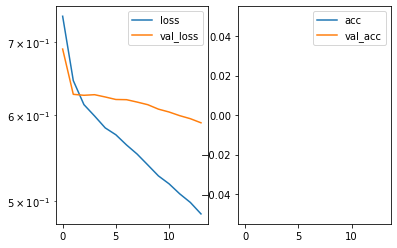

Predicted cell: Landmark Probability: [[0.76341766]]
True Cell type: Landmark
x [[0.21910372]]
True positional value x 0.578125
y [[0.53725076]]
True positional value y 0.578125


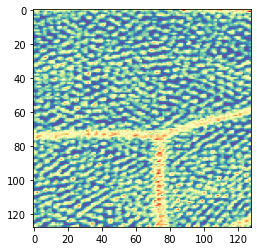

Epoch 15/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.4804 - accuracy: 0.9104 - val_loss: 0.5858 - val_accuracy: 0.8857

Epoch 00015: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5857599228620529, 'val_accuracy': 0.8857142925262451, 'loss': 0.48037731788872956, 'accuracy': 0.91039157, 'lr': 1e-06}


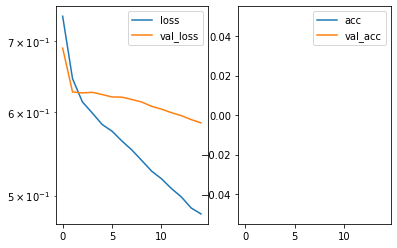

Predicted cell: Landmark Probability: [[0.9495317]]
True Cell type: Landmark
x [[0.45112664]]
True positional value x 0.5
y [[0.58257645]]
True positional value y 0.578125


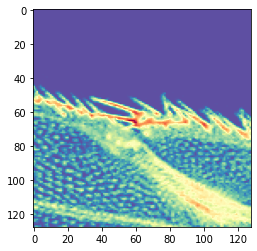

Epoch 16/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.4733 - accuracy: 0.9134 - val_loss: 0.5832 - val_accuracy: 0.8929

Epoch 00016: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5831752611058099, 'val_accuracy': 0.8928571343421936, 'loss': 0.47334277198975344, 'accuracy': 0.91340363, 'lr': 1e-06}


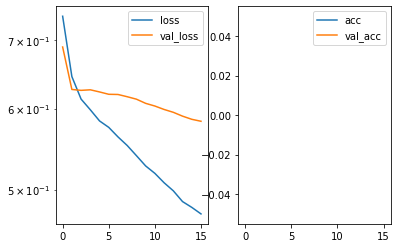

Predicted cell: Landmark Probability: [[0.9568227]]
True Cell type: Landmark
x [[0.45452583]]
True positional value x 0.5
y [[0.56166583]]
True positional value y 0.578125


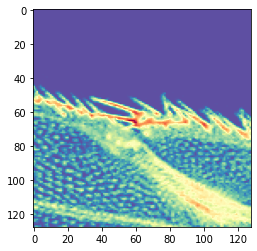

Epoch 17/250
2656/2656 [==============================] - 12s 5ms/step - loss: 0.4663 - accuracy: 0.9149 - val_loss: 0.5800 - val_accuracy: 0.8929

Epoch 00017: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.579961325441088, 'val_accuracy': 0.8928571343421936, 'loss': 0.4663003700594586, 'accuracy': 0.91490966, 'lr': 1e-06}


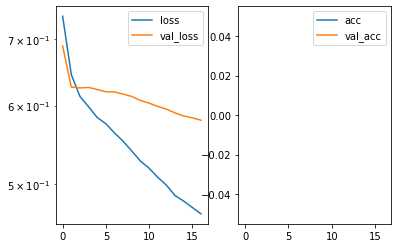

Predicted cell: Landmark Probability: [[0.8786855]]
True Cell type: Landmark
x [[0.60235596]]
True positional value x 0.578125
y [[0.54309493]]
True positional value y 0.578125


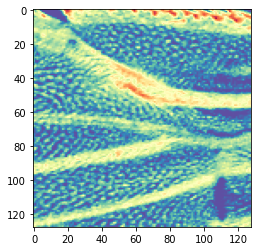

Epoch 18/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.4558 - accuracy: 0.9168 - val_loss: 0.5780 - val_accuracy: 0.8929

Epoch 00018: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5779803139822823, 'val_accuracy': 0.8928571343421936, 'loss': 0.45580396641898585, 'accuracy': 0.91679215, 'lr': 1e-06}


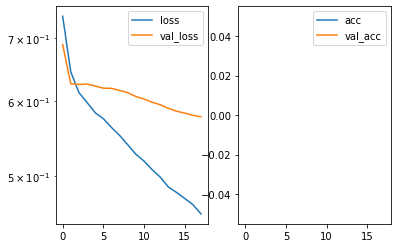

Predicted cell: Landmark Probability: [[0.9521654]]
True Cell type: Landmark
x [[0.6378552]]
True positional value x 0.5
y [[0.39069244]]
True positional value y 0.5


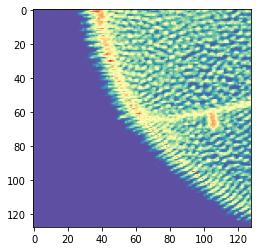

Epoch 19/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.4490 - accuracy: 0.9183 - val_loss: 0.5769 - val_accuracy: 0.8929

Epoch 00019: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.576888986996242, 'val_accuracy': 0.8928571343421936, 'loss': 0.4489637743008424, 'accuracy': 0.9182982, 'lr': 1e-06}


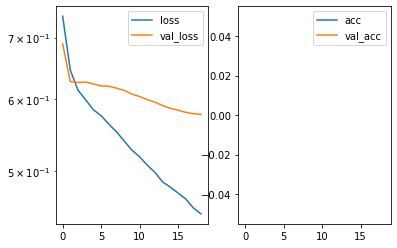

Predicted cell: Landmark Probability: [[0.9375497]]
True Cell type: Landmark
x [[0.4925048]]
True positional value x 0.578125
y [[0.34182143]]
True positional value y 0.5


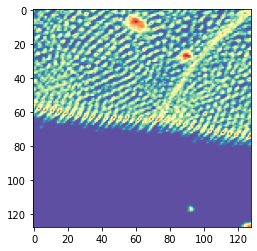

Epoch 20/250
2656/2656 [==============================] - 13s 5ms/step - loss: 0.4426 - accuracy: 0.9236 - val_loss: 0.5687 - val_accuracy: 0.8929

Epoch 00020: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5687125431639808, 'val_accuracy': 0.8928571343421936, 'loss': 0.4426261804414442, 'accuracy': 0.92356926, 'lr': 1e-06}


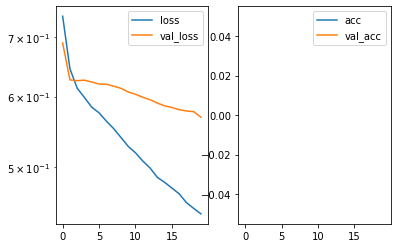

Predicted cell: Landmark Probability: [[0.99357754]]
True Cell type: Landmark
x [[0.17062157]]
True positional value x 0.421875
y [[0.5608619]]
True positional value y 0.421875


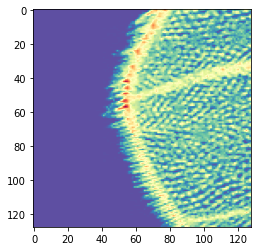

Epoch 21/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.4387 - accuracy: 0.9236 - val_loss: 0.5657 - val_accuracy: 0.8929

Epoch 00021: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5657081454992294, 'val_accuracy': 0.8928571343421936, 'loss': 0.4386672873319273, 'accuracy': 0.92356926, 'lr': 1e-06}


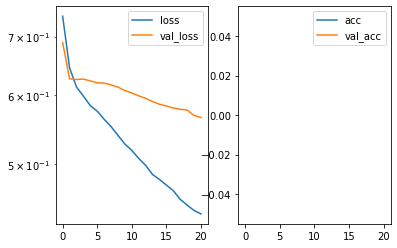

Predicted cell: Landmark Probability: [[0.8692249]]
True Cell type: Landmark
x [[0.6575107]]
True positional value x 0.578125
y [[0.53901714]]
True positional value y 0.578125


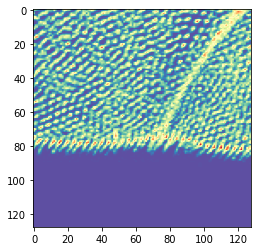

Epoch 22/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.4292 - accuracy: 0.9239 - val_loss: 0.5678 - val_accuracy: 0.8929

Epoch 00022: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5678498659815107, 'val_accuracy': 0.8928571343421936, 'loss': 0.429203004385513, 'accuracy': 0.9239458, 'lr': 1e-06}


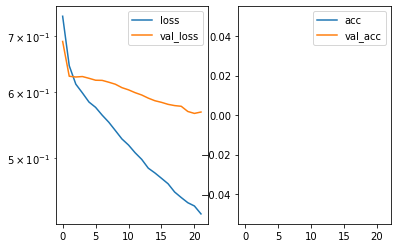

Predicted cell: Landmark Probability: [[0.8625407]]
True Cell type: Background
x [[0.35553953]]
True positional value x 0.5
y [[0.37309834]]
True positional value y 0.5


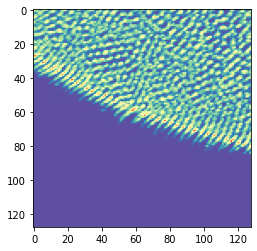

Epoch 23/250
2656/2656 [==============================] - 12s 5ms/step - loss: 0.4271 - accuracy: 0.9300 - val_loss: 0.5637 - val_accuracy: 0.8929

Epoch 00023: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5637392316545758, 'val_accuracy': 0.8928571343421936, 'loss': 0.42707087279084216, 'accuracy': 0.9299699, 'lr': 1e-06}


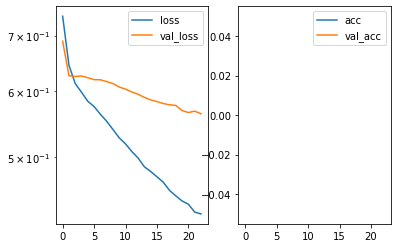

Predicted cell: Landmark Probability: [[0.83509076]]
True Cell type: Landmark
x [[0.6364881]]
True positional value x 0.578125
y [[0.40185386]]
True positional value y 0.578125


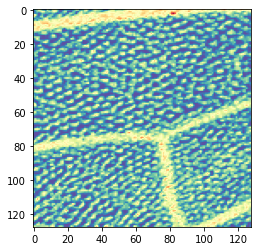

Epoch 24/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.4201 - accuracy: 0.9311 - val_loss: 0.5599 - val_accuracy: 0.8929

Epoch 00024: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5599087285143989, 'val_accuracy': 0.8928571343421936, 'loss': 0.42010706640690204, 'accuracy': 0.9310994, 'lr': 1e-06}


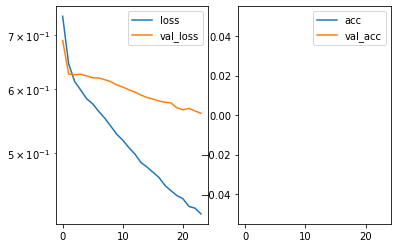

Predicted cell: Landmark Probability: [[0.7079679]]
True Cell type: Landmark
x [[0.43452406]]
True positional value x 0.421875
y [[0.33967525]]
True positional value y 0.421875


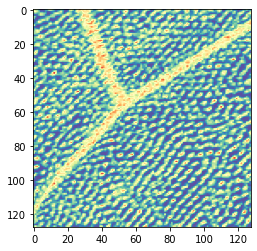

Epoch 25/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.4144 - accuracy: 0.9337 - val_loss: 0.5580 - val_accuracy: 0.8929

Epoch 00025: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5579606571367809, 'val_accuracy': 0.8928571343421936, 'loss': 0.41444511852978944, 'accuracy': 0.93373495, 'lr': 1e-06}


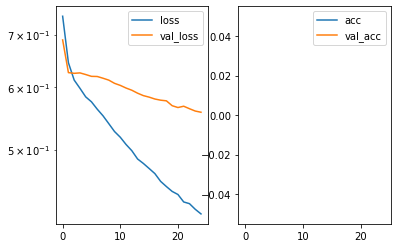

Predicted cell: Landmark Probability: [[0.97495544]]
True Cell type: Landmark
x [[0.5850244]]
True positional value x 0.578125
y [[0.5287258]]
True positional value y 0.5


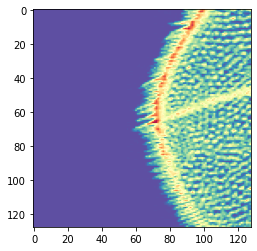

Epoch 26/250
2656/2656 [==============================] - 12s 4ms/step - loss: 0.4102 - accuracy: 0.9352 - val_loss: 0.5642 - val_accuracy: 0.8929

Epoch 00026: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5642369793994086, 'val_accuracy': 0.8928571343421936, 'loss': 0.4101797594318548, 'accuracy': 0.935241, 'lr': 1e-06}


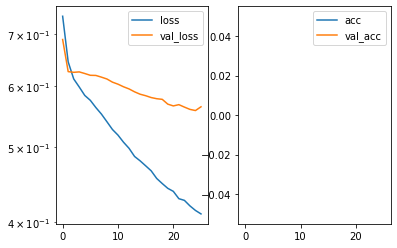

Predicted cell: Landmark Probability: [[0.9823778]]
True Cell type: Landmark
x [[0.89772683]]
True positional value x 0.578125
y [[0.6809907]]
True positional value y 0.578125


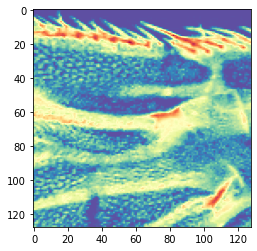

Epoch 27/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.4073 - accuracy: 0.9360 - val_loss: 0.5561 - val_accuracy: 0.8929

Epoch 00027: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5560671495539802, 'val_accuracy': 0.8928571343421936, 'loss': 0.4073207153747958, 'accuracy': 0.93599397, 'lr': 1e-06}


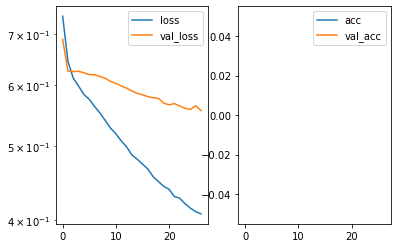

Predicted cell: Landmark Probability: [[0.94094515]]
True Cell type: Landmark
x [[0.49267328]]
True positional value x 0.421875
y [[0.5274868]]
True positional value y 0.578125


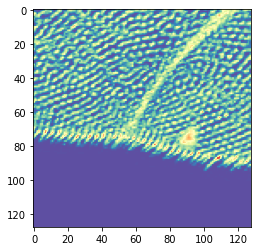

Epoch 28/250
2656/2656 [==============================] - 12s 5ms/step - loss: 0.4010 - accuracy: 0.9401 - val_loss: 0.5507 - val_accuracy: 0.8929

Epoch 00028: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5507360654217857, 'val_accuracy': 0.8928571343421936, 'loss': 0.400975303410227, 'accuracy': 0.94013554, 'lr': 1e-06}


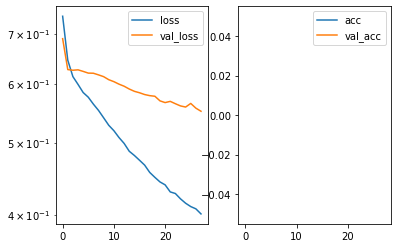

Predicted cell: Landmark Probability: [[0.9670563]]
True Cell type: Landmark
x [[0.35507545]]
True positional value x 0.421875
y [[0.56065726]]
True positional value y 0.421875


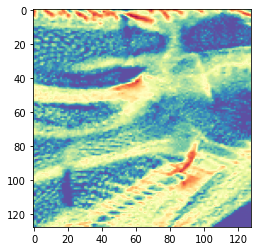

Epoch 29/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.3955 - accuracy: 0.9409 - val_loss: 0.5495 - val_accuracy: 0.9000

Epoch 00029: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5494709142616817, 'val_accuracy': 0.8999999761581421, 'loss': 0.3954797329224018, 'accuracy': 0.9408886, 'lr': 1e-06}


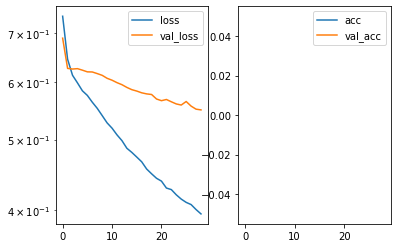

Predicted cell: Landmark Probability: [[0.9924591]]
True Cell type: Landmark
x [[0.6547739]]
True positional value x 0.578125
y [[0.59486467]]
True positional value y 0.578125


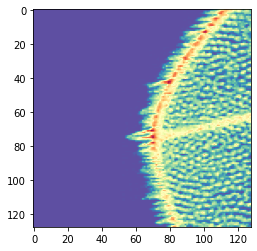

Epoch 30/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.3931 - accuracy: 0.9458 - val_loss: 0.5516 - val_accuracy: 0.9000

Epoch 00030: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.55156452528068, 'val_accuracy': 0.8999999761581421, 'loss': 0.39312046178313625, 'accuracy': 0.94578314, 'lr': 1e-06}


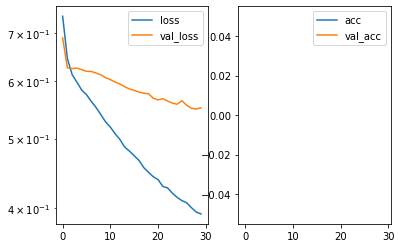

Predicted cell: Landmark Probability: [[0.8476968]]
True Cell type: Background
x [[0.44946378]]
True positional value x 0.5
y [[0.7226593]]
True positional value y 0.5


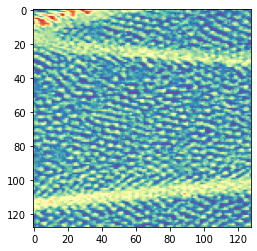

Epoch 31/250
2656/2656 [==============================] - 12s 5ms/step - loss: 0.3909 - accuracy: 0.9480 - val_loss: 0.5443 - val_accuracy: 0.9000

Epoch 00031: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5442784747907093, 'val_accuracy': 0.8999999761581421, 'loss': 0.3909410835210099, 'accuracy': 0.94804215, 'lr': 1e-06}


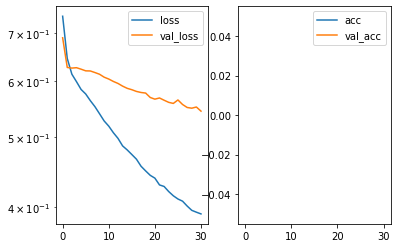

Predicted cell: Landmark Probability: [[0.9079815]]
True Cell type: Landmark
x [[0.685506]]
True positional value x 0.5
y [[0.69570786]]
True positional value y 0.421875


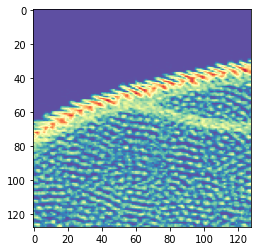

Epoch 32/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.3849 - accuracy: 0.9544 - val_loss: 0.5493 - val_accuracy: 0.9000

Epoch 00032: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5492888752903257, 'val_accuracy': 0.8999999761581421, 'loss': 0.3849412418946803, 'accuracy': 0.9544428, 'lr': 1e-06}


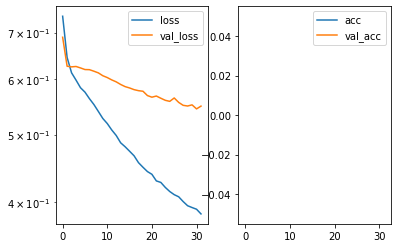

Predicted cell: Landmark Probability: [[0.98137456]]
True Cell type: Landmark
x [[0.45305613]]
True positional value x 0.578125
y [[0.6582988]]
True positional value y 0.421875


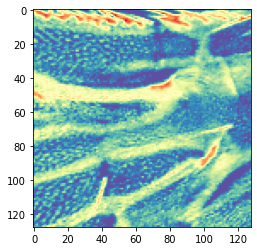

Epoch 33/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.3814 - accuracy: 0.9480 - val_loss: 0.5476 - val_accuracy: 0.9000

Epoch 00033: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5475935403789792, 'val_accuracy': 0.8999999761581421, 'loss': 0.3813545332480985, 'accuracy': 0.94804215, 'lr': 1e-06}


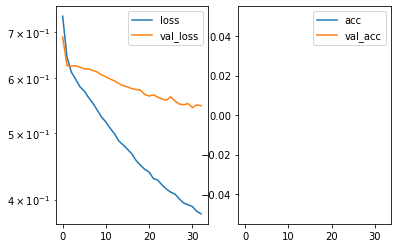

Predicted cell: Landmark Probability: [[0.9643936]]
True Cell type: Landmark
x [[0.7939556]]
True positional value x 0.5
y [[0.4615398]]
True positional value y 0.578125


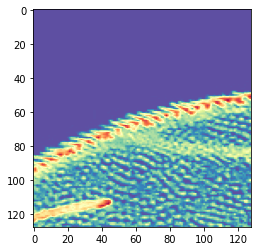

Epoch 34/250
2656/2656 [==============================] - 13s 5ms/step - loss: 0.3751 - accuracy: 0.9537 - val_loss: 0.5514 - val_accuracy: 0.9000

Epoch 00034: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5514317750930786, 'val_accuracy': 0.8999999761581421, 'loss': 0.37508547180388346, 'accuracy': 0.95368975, 'lr': 1e-06}


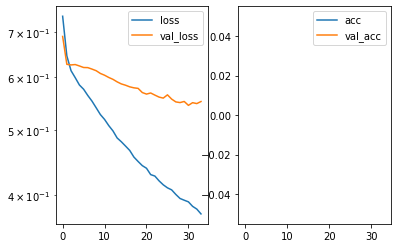

Predicted cell: Landmark Probability: [[0.99366814]]
True Cell type: Landmark
x [[0.6203597]]
True positional value x 0.578125
y [[0.3541601]]
True positional value y 0.5


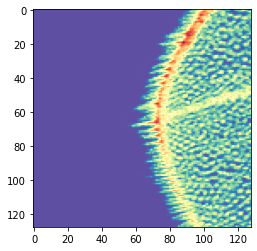

Epoch 35/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.3741 - accuracy: 0.9541 - val_loss: 0.5425 - val_accuracy: 0.9071

Epoch 00035: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.542548411658832, 'val_accuracy': 0.9071428775787354, 'loss': 0.3741214908210628, 'accuracy': 0.9540663, 'lr': 1e-06}


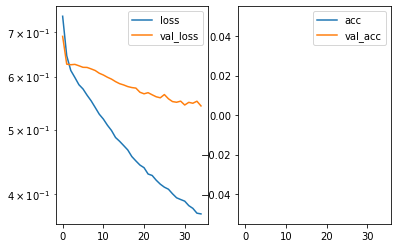

Predicted cell: Landmark Probability: [[0.9525825]]
True Cell type: Landmark
x [[0.63050985]]
True positional value x 0.578125
y [[0.42662182]]
True positional value y 0.578125


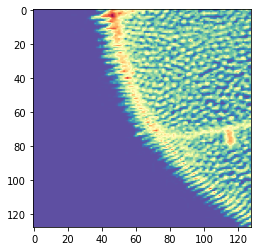

Epoch 36/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.3689 - accuracy: 0.9597 - val_loss: 0.5504 - val_accuracy: 0.9000

Epoch 00036: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5504372460501534, 'val_accuracy': 0.8999999761581421, 'loss': 0.36885640507631273, 'accuracy': 0.9597139, 'lr': 1e-06}


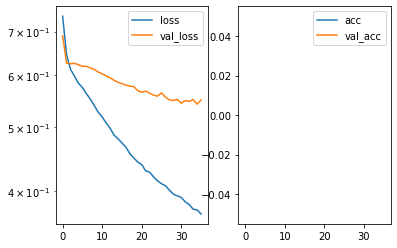

Predicted cell: Landmark Probability: [[0.9553707]]
True Cell type: Landmark
x [[0.31376234]]
True positional value x 0.421875
y [[0.5749869]]
True positional value y 0.5


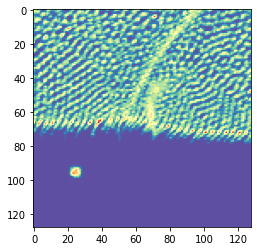

Epoch 37/250
2656/2656 [==============================] - 13s 5ms/step - loss: 0.3669 - accuracy: 0.9597 - val_loss: 0.5405 - val_accuracy: 0.9071

Epoch 00037: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.540451820407595, 'val_accuracy': 0.9071428775787354, 'loss': 0.36693171111036493, 'accuracy': 0.9597139, 'lr': 1e-06}


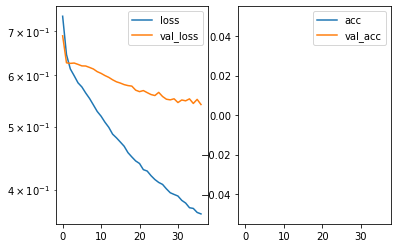

Predicted cell: Landmark Probability: [[0.97833556]]
True Cell type: Landmark
x [[0.45248625]]
True positional value x 0.5
y [[0.4572434]]
True positional value y 0.421875


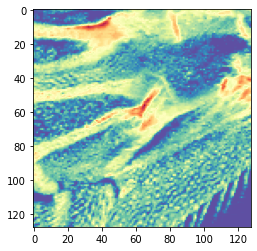

Epoch 38/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.3659 - accuracy: 0.9620 - val_loss: 0.5411 - val_accuracy: 0.9071

Epoch 00038: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5410961125578199, 'val_accuracy': 0.9071428775787354, 'loss': 0.3659038917127862, 'accuracy': 0.9619729, 'lr': 1e-06}


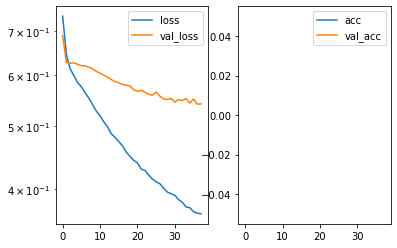

Predicted cell: Landmark Probability: [[0.94281864]]
True Cell type: Landmark
x [[0.60559076]]
True positional value x 0.578125
y [[0.56475556]]
True positional value y 0.578125


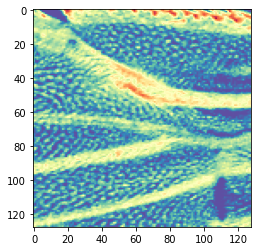

Epoch 39/250
2656/2656 [==============================] - 12s 4ms/step - loss: 0.3620 - accuracy: 0.9639 - val_loss: 0.5483 - val_accuracy: 0.9071

Epoch 00039: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5483136602810451, 'val_accuracy': 0.9071428775787354, 'loss': 0.3620360232440822, 'accuracy': 0.96385545, 'lr': 1e-06}


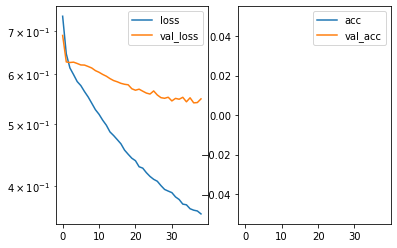

Predicted cell: Landmark Probability: [[0.9989544]]
True Cell type: Landmark
x [[0.553468]]
True positional value x 0.5
y [[0.6363108]]
True positional value y 0.421875


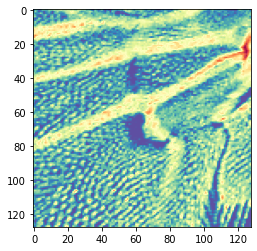

Epoch 40/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.3586 - accuracy: 0.9639 - val_loss: 0.5443 - val_accuracy: 0.9071

Epoch 00040: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5442658918244498, 'val_accuracy': 0.9071428775787354, 'loss': 0.3585696399705597, 'accuracy': 0.96385545, 'lr': 1e-06}


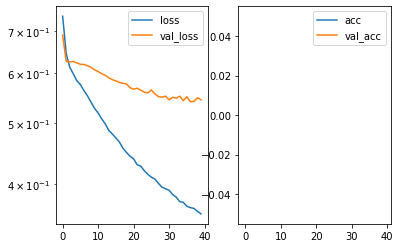

Predicted cell: Landmark Probability: [[0.9096471]]
True Cell type: Landmark
x [[0.7031487]]
True positional value x 0.578125
y [[0.5250852]]
True positional value y 0.421875


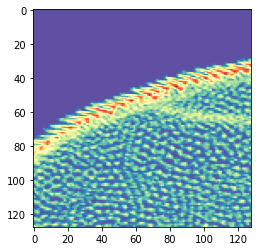

Epoch 41/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.3545 - accuracy: 0.9695 - val_loss: 0.5367 - val_accuracy: 0.9071

Epoch 00041: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5366696800504412, 'val_accuracy': 0.9071428775787354, 'loss': 0.3544788951256189, 'accuracy': 0.969503, 'lr': 1e-06}


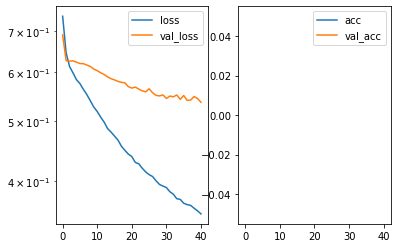

Predicted cell: Landmark Probability: [[0.98255205]]
True Cell type: Landmark
x [[0.4050625]]
True positional value x 0.421875
y [[0.5454219]]
True positional value y 0.578125


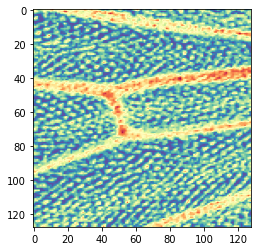

Epoch 42/250
2656/2656 [==============================] - 12s 4ms/step - loss: 0.3523 - accuracy: 0.9721 - val_loss: 0.5433 - val_accuracy: 0.9000

Epoch 00042: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5432526022195816, 'val_accuracy': 0.8999999761581421, 'loss': 0.35227431567857065, 'accuracy': 0.9721386, 'lr': 1e-06}


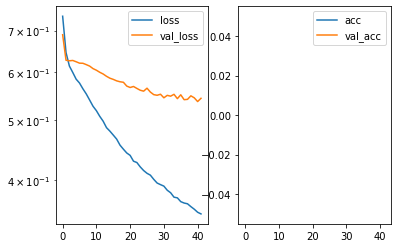

Predicted cell: Landmark Probability: [[0.9235292]]
True Cell type: Landmark
x [[0.2724773]]
True positional value x 0.578125
y [[0.66501945]]
True positional value y 0.578125


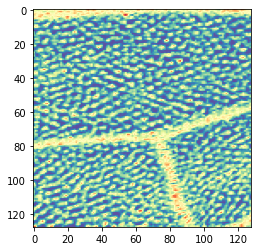

Epoch 43/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.3492 - accuracy: 0.9714 - val_loss: 0.5460 - val_accuracy: 0.9071

Epoch 00043: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.545973886336599, 'val_accuracy': 0.9071428775787354, 'loss': 0.34919277930923975, 'accuracy': 0.97138554, 'lr': 1e-06}


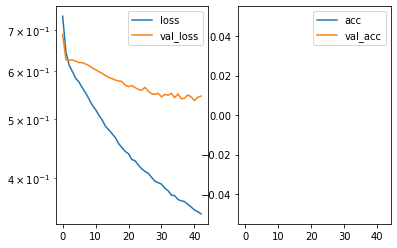

Predicted cell: Landmark Probability: [[0.8800262]]
True Cell type: Background
x [[0.37792432]]
True positional value x 0.5
y [[0.35614944]]
True positional value y 0.5


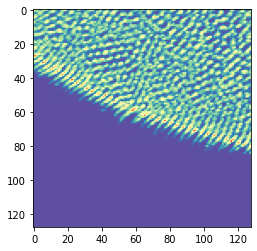

Epoch 44/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.3451 - accuracy: 0.9729 - val_loss: 0.5405 - val_accuracy: 0.9071

Epoch 00044: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.540539779833385, 'val_accuracy': 0.9071428775787354, 'loss': 0.3451328065740057, 'accuracy': 0.97289157, 'lr': 1e-06}


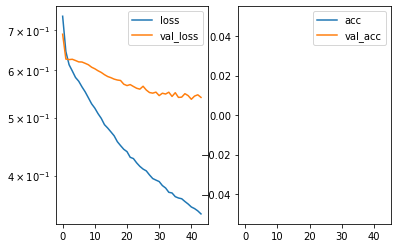

Predicted cell: Landmark Probability: [[0.94227225]]
True Cell type: Landmark
x [[0.60226136]]
True positional value x 0.421875
y [[0.25769603]]
True positional value y 0.421875


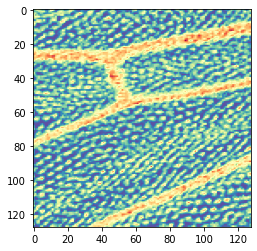

Epoch 45/250
2656/2656 [==============================] - 12s 5ms/step - loss: 0.3411 - accuracy: 0.9778 - val_loss: 0.5523 - val_accuracy: 0.9071

Epoch 00045: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.55233120066779, 'val_accuracy': 0.9071428775787354, 'loss': 0.34111276953425035, 'accuracy': 0.9777861, 'lr': 1e-06}


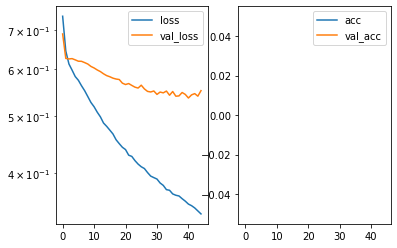

Predicted cell: Landmark Probability: [[0.9262958]]
True Cell type: Landmark
x [[0.6899573]]
True positional value x 0.578125
y [[0.5376557]]
True positional value y 0.421875


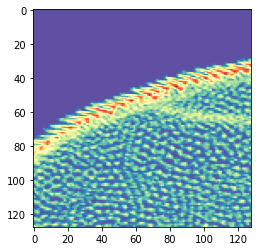

Epoch 46/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.3404 - accuracy: 0.9740 - val_loss: 0.5401 - val_accuracy: 0.9071

Epoch 00046: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5400911058698382, 'val_accuracy': 0.9071428775787354, 'loss': 0.3403698921831976, 'accuracy': 0.9740211, 'lr': 1e-06}


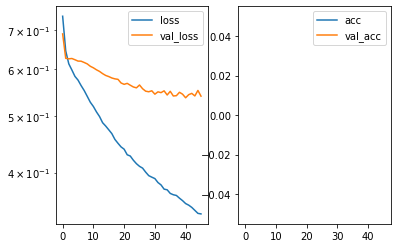

Predicted cell: Landmark Probability: [[0.9290634]]
True Cell type: Landmark
x [[0.51944]]
True positional value x 0.5
y [[0.62157863]]
True positional value y 0.421875


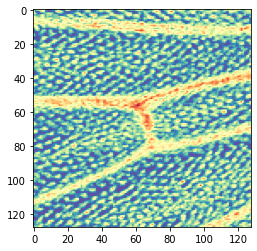

Epoch 47/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.3401 - accuracy: 0.9767 - val_loss: 0.5337 - val_accuracy: 0.9071

Epoch 00047: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5336870338235583, 'val_accuracy': 0.9071428775787354, 'loss': 0.34008563161793964, 'accuracy': 0.9766566, 'lr': 1e-06}


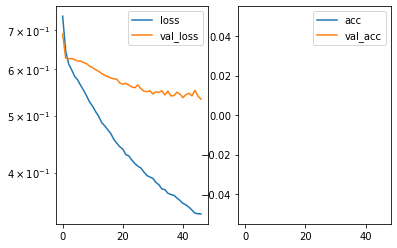

Predicted cell: Landmark Probability: [[0.8700629]]
True Cell type: Background
x [[0.38151887]]
True positional value x 0.5
y [[0.35793835]]
True positional value y 0.5


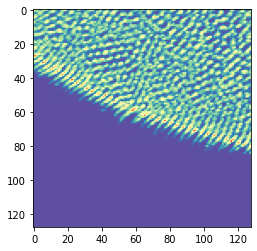

Epoch 48/250
2656/2656 [==============================] - 12s 5ms/step - loss: 0.3377 - accuracy: 0.9812 - val_loss: 0.5431 - val_accuracy: 0.9071

Epoch 00048: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5431479194334575, 'val_accuracy': 0.9071428775787354, 'loss': 0.33772339588816624, 'accuracy': 0.9811747, 'lr': 1e-06}


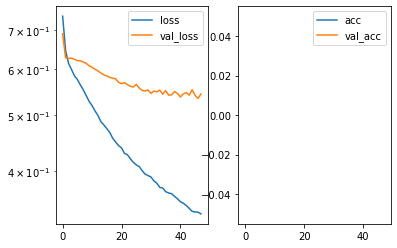

Predicted cell: Landmark Probability: [[0.99534273]]
True Cell type: Landmark
x [[0.59545416]]
True positional value x 0.578125
y [[0.35206145]]
True positional value y 0.5


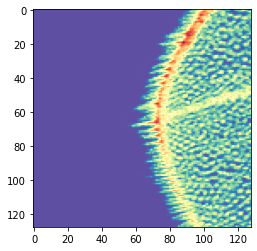

Epoch 49/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.3341 - accuracy: 0.9797 - val_loss: 0.5318 - val_accuracy: 0.9071

Epoch 00049: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5318436729056495, 'val_accuracy': 0.9071428775787354, 'loss': 0.3340766103377184, 'accuracy': 0.9796687, 'lr': 1e-06}


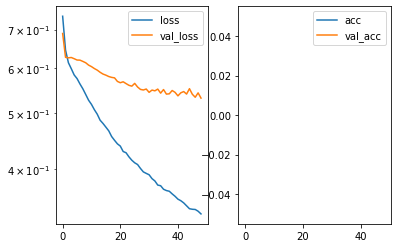

Predicted cell: Landmark Probability: [[0.97799486]]
True Cell type: Landmark
x [[0.5275759]]
True positional value x 0.578125
y [[0.5292013]]
True positional value y 0.421875


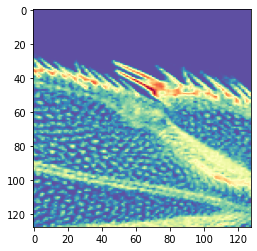

Epoch 50/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.3322 - accuracy: 0.9819 - val_loss: 0.5314 - val_accuracy: 0.9071

Epoch 00050: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5314072285379682, 'val_accuracy': 0.9071428775787354, 'loss': 0.3322489576257137, 'accuracy': 0.9819277, 'lr': 1e-06}


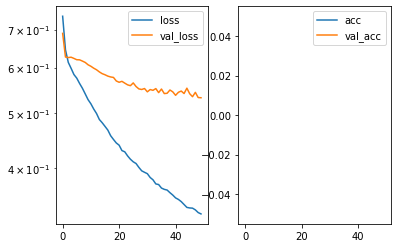

Predicted cell: Landmark Probability: [[0.99223137]]
True Cell type: Landmark
x [[0.38620624]]
True positional value x 0.421875
y [[0.69803196]]
True positional value y 0.578125


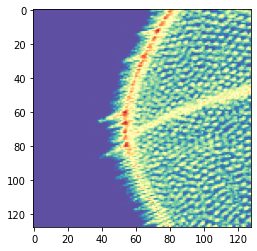

Epoch 51/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.3309 - accuracy: 0.9808 - val_loss: 0.5311 - val_accuracy: 0.9071

Epoch 00051: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.531079175216811, 'val_accuracy': 0.9071428775787354, 'loss': 0.3309150112635759, 'accuracy': 0.9807982, 'lr': 1e-06}


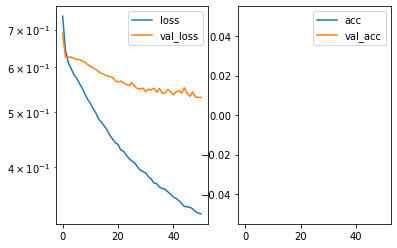

Predicted cell: Landmark Probability: [[0.984969]]
True Cell type: Landmark
x [[0.27400604]]
True positional value x 0.421875
y [[0.40175635]]
True positional value y 0.5


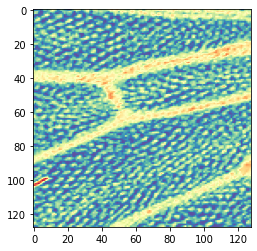

Epoch 52/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.3295 - accuracy: 0.9846 - val_loss: 0.5388 - val_accuracy: 0.9071

Epoch 00052: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5387753290789468, 'val_accuracy': 0.9071428775787354, 'loss': 0.3294948585421206, 'accuracy': 0.98456323, 'lr': 1e-06}


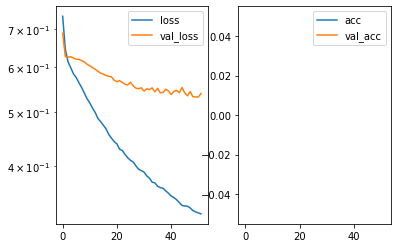

Predicted cell: Landmark Probability: [[0.8233275]]
True Cell type: Landmark
x [[0.49931413]]
True positional value x 0.421875
y [[0.5777891]]
True positional value y 0.578125


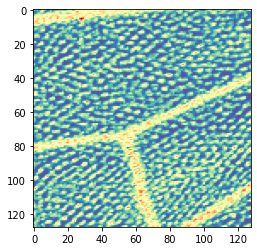

Epoch 53/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.3253 - accuracy: 0.9887 - val_loss: 0.5417 - val_accuracy: 0.9071

Epoch 00053: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5417496051107135, 'val_accuracy': 0.9071428775787354, 'loss': 0.32532826577683527, 'accuracy': 0.9887048, 'lr': 1e-06}


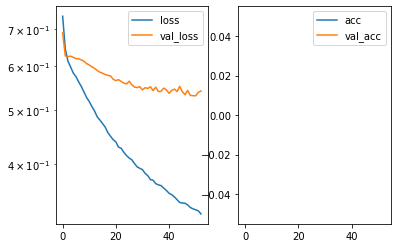

Predicted cell: Landmark Probability: [[0.9900142]]
True Cell type: Landmark
x [[0.3196865]]
True positional value x 0.5
y [[0.6411907]]
True positional value y 0.578125


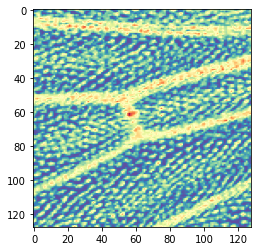

Epoch 54/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.3281 - accuracy: 0.9846 - val_loss: 0.5424 - val_accuracy: 0.9071

Epoch 00054: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5424430029732841, 'val_accuracy': 0.9071428775787354, 'loss': 0.3281369046588619, 'accuracy': 0.98456323, 'lr': 1e-06}


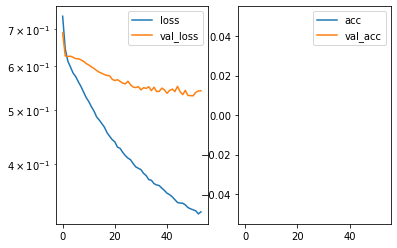

Predicted cell: Landmark Probability: [[0.98126537]]
True Cell type: Landmark
x [[0.50538903]]
True positional value x 0.5
y [[0.6087411]]
True positional value y 0.578125


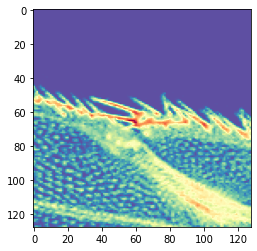

Epoch 55/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.3225 - accuracy: 0.9849 - val_loss: 0.5391 - val_accuracy: 0.9071

Epoch 00055: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5390562138387135, 'val_accuracy': 0.9071428775787354, 'loss': 0.322542797841401, 'accuracy': 0.98493975, 'lr': 1e-06}


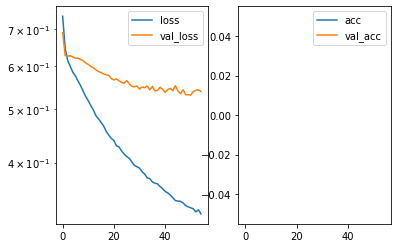

Predicted cell: Landmark Probability: [[0.85260814]]
True Cell type: Landmark
x [[0.31749403]]
True positional value x 0.5
y [[0.3723875]]
True positional value y 0.421875


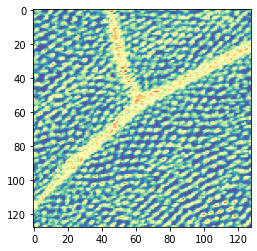

Epoch 56/250
2656/2656 [==============================] - 12s 5ms/step - loss: 0.3252 - accuracy: 0.9846 - val_loss: 0.5220 - val_accuracy: 0.9071

Epoch 00056: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5219617656299046, 'val_accuracy': 0.9071428775787354, 'loss': 0.32522119135113364, 'accuracy': 0.98456323, 'lr': 1e-06}


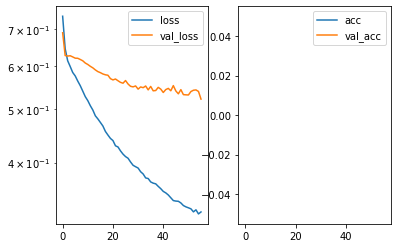

Predicted cell: Landmark Probability: [[0.97956353]]
True Cell type: Landmark
x [[0.25287503]]
True positional value x 0.5
y [[0.5286933]]
True positional value y 0.578125


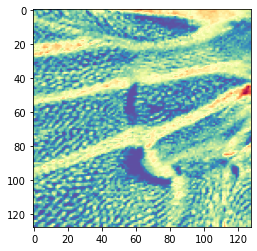

Epoch 57/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.3198 - accuracy: 0.9887 - val_loss: 0.5286 - val_accuracy: 0.9071

Epoch 00057: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5285677909851074, 'val_accuracy': 0.9071428775787354, 'loss': 0.31983121973742923, 'accuracy': 0.9887048, 'lr': 1e-06}


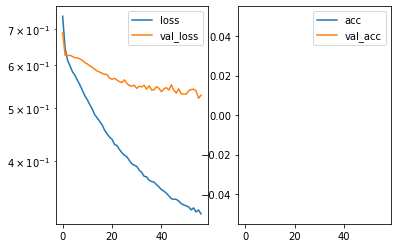

Predicted cell: Landmark Probability: [[0.9393159]]
True Cell type: Landmark
x [[0.61518395]]
True positional value x 0.421875
y [[0.4911936]]
True positional value y 0.578125


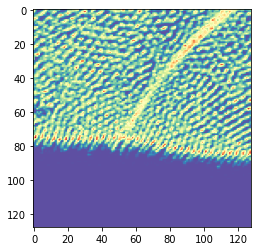

Epoch 58/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.3196 - accuracy: 0.9887 - val_loss: 0.5312 - val_accuracy: 0.9071

Epoch 00058: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5311539939471653, 'val_accuracy': 0.9071428775787354, 'loss': 0.3196143187717142, 'accuracy': 0.9887048, 'lr': 1e-06}


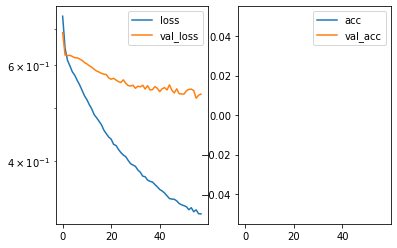

Predicted cell: Landmark Probability: [[0.97266567]]
True Cell type: Landmark
x [[0.36310714]]
True positional value x 0.5
y [[0.5523587]]
True positional value y 0.5


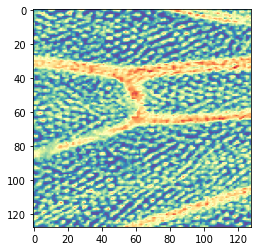

Epoch 59/250
2656/2656 [==============================] - 12s 5ms/step - loss: 0.3174 - accuracy: 0.9906 - val_loss: 0.5267 - val_accuracy: 0.9071

Epoch 00059: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5267358039106641, 'val_accuracy': 0.9071428775787354, 'loss': 0.3173541871449315, 'accuracy': 0.99058735, 'lr': 1e-06}


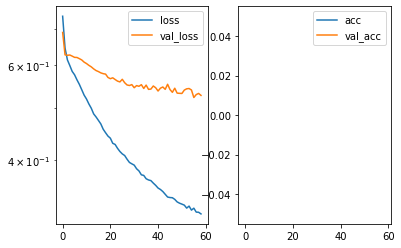

Predicted cell: Landmark Probability: [[0.984048]]
True Cell type: Landmark
x [[0.6435155]]
True positional value x 0.5
y [[0.63168883]]
True positional value y 0.578125


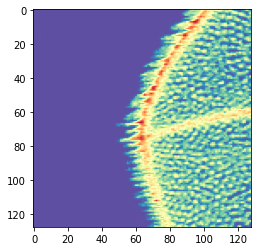

Epoch 60/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.3173 - accuracy: 0.9913 - val_loss: 0.5393 - val_accuracy: 0.9071

Epoch 00060: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5393014401197433, 'val_accuracy': 0.9071428775787354, 'loss': 0.31734407565231065, 'accuracy': 0.99134034, 'lr': 1e-06}


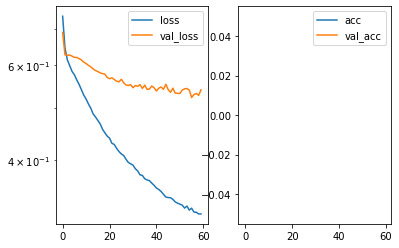

Predicted cell: Landmark Probability: [[0.98019993]]
True Cell type: Landmark
x [[0.8183164]]
True positional value x 0.578125
y [[0.3564801]]
True positional value y 0.421875


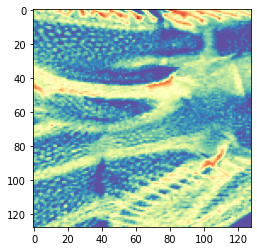

Epoch 61/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.3143 - accuracy: 0.9910 - val_loss: 0.5276 - val_accuracy: 0.9071

Epoch 00061: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5276117899588176, 'val_accuracy': 0.9071428775787354, 'loss': 0.3142679519278098, 'accuracy': 0.9909639, 'lr': 1e-06}


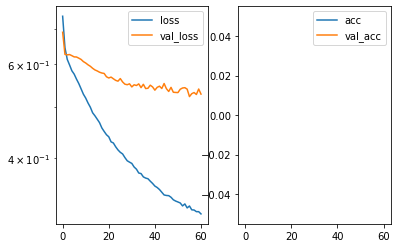

Predicted cell: Landmark Probability: [[0.9858586]]
True Cell type: Landmark
x [[0.57401145]]
True positional value x 0.578125
y [[0.53806233]]
True positional value y 0.5


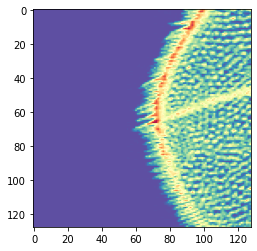

Epoch 62/250
2656/2656 [==============================] - 12s 5ms/step - loss: 0.3142 - accuracy: 0.9906 - val_loss: 0.5287 - val_accuracy: 0.9071

Epoch 00062: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5286541432142258, 'val_accuracy': 0.9071428775787354, 'loss': 0.31424418019961164, 'accuracy': 0.99058735, 'lr': 1e-06}


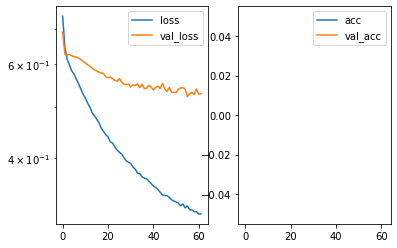

Predicted cell: Landmark Probability: [[0.95290416]]
True Cell type: Landmark
x [[0.44401413]]
True positional value x 0.421875
y [[0.41063944]]
True positional value y 0.5


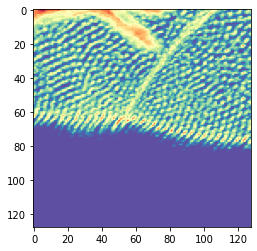

Epoch 63/250
2656/2656 [==============================] - 12s 4ms/step - loss: 0.3109 - accuracy: 0.9955 - val_loss: 0.5458 - val_accuracy: 0.9071

Epoch 00063: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5457679331302643, 'val_accuracy': 0.9071428775787354, 'loss': 0.31090721196259363, 'accuracy': 0.9954819, 'lr': 1e-06}


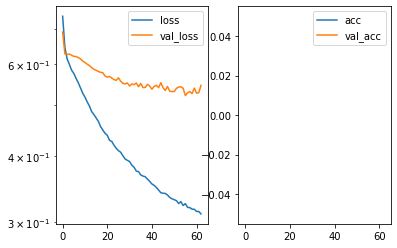

Predicted cell: Landmark Probability: [[0.99798954]]
True Cell type: Landmark
x [[0.3177083]]
True positional value x 0.421875
y [[0.50036585]]
True positional value y 0.421875


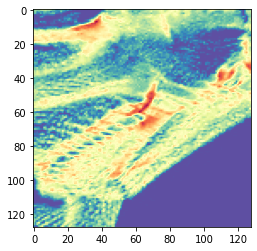

Epoch 64/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.3112 - accuracy: 0.9936 - val_loss: 0.5451 - val_accuracy: 0.9071

Epoch 00064: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5451310234410423, 'val_accuracy': 0.9071428775787354, 'loss': 0.3111702163355896, 'accuracy': 0.9935994, 'lr': 1e-06}


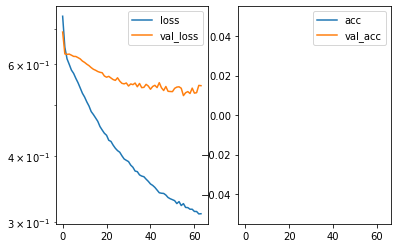

Predicted cell: Landmark Probability: [[0.9673382]]
True Cell type: Landmark
x [[0.58022875]]
True positional value x 0.5
y [[0.564709]]
True positional value y 0.421875


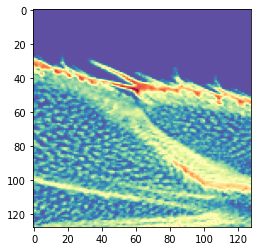

Epoch 65/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.3091 - accuracy: 0.9962 - val_loss: 0.5489 - val_accuracy: 0.9071

Epoch 00065: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.548927577478545, 'val_accuracy': 0.9071428775787354, 'loss': 0.30907564850366975, 'accuracy': 0.99623495, 'lr': 1e-06}


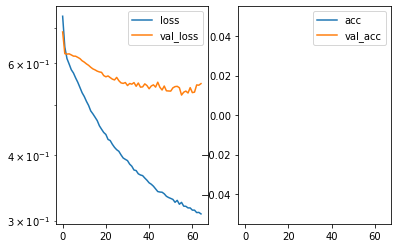

Predicted cell: Landmark Probability: [[0.99445784]]
True Cell type: Landmark
x [[0.35241017]]
True positional value x 0.421875
y [[0.50150645]]
True positional value y 0.421875


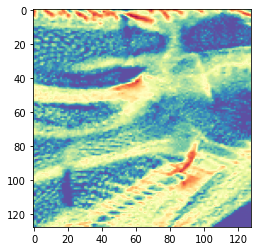

Epoch 66/250
2656/2656 [==============================] - 12s 5ms/step - loss: 0.3101 - accuracy: 0.9921 - val_loss: 0.5657 - val_accuracy: 0.9071

Epoch 00066: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5656538775988987, 'val_accuracy': 0.9071428775787354, 'loss': 0.31010150586266116, 'accuracy': 0.9920934, 'lr': 1e-06}


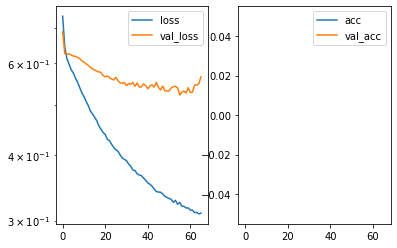

Predicted cell: Landmark Probability: [[0.9507626]]
True Cell type: Background
x [[0.72914237]]
True positional value x 0.5
y [[0.20486522]]
True positional value y 0.5


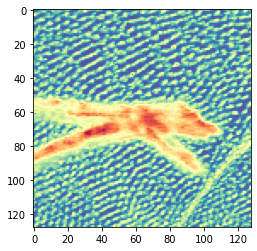

Epoch 67/250
2656/2656 [==============================] - 13s 5ms/step - loss: 0.3074 - accuracy: 0.9928 - val_loss: 0.5427 - val_accuracy: 0.9071

Epoch 00067: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5427172822611672, 'val_accuracy': 0.9071428775787354, 'loss': 0.30740673976939126, 'accuracy': 0.99284637, 'lr': 1e-06}


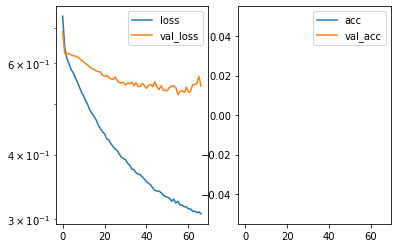

Predicted cell: Landmark Probability: [[0.9513387]]
True Cell type: Landmark
x [[0.62170947]]
True positional value x 0.5
y [[0.48380357]]
True positional value y 0.578125


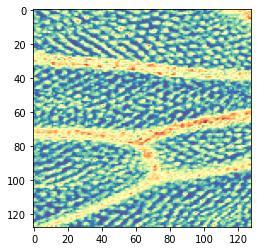

Epoch 68/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.3069 - accuracy: 0.9959 - val_loss: 0.5309 - val_accuracy: 0.9071

Epoch 00068: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5309174507856369, 'val_accuracy': 0.9071428775787354, 'loss': 0.306905353509159, 'accuracy': 0.99585843, 'lr': 1e-06}


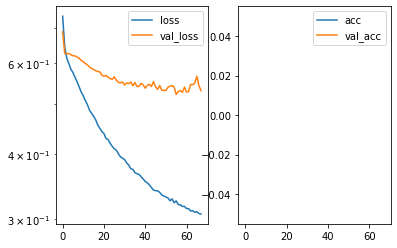

Predicted cell: Landmark Probability: [[0.9924137]]
True Cell type: Landmark
x [[0.3553803]]
True positional value x 0.421875
y [[0.49133277]]
True positional value y 0.421875


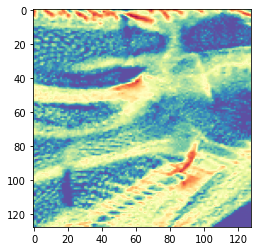

Epoch 69/250
2656/2656 [==============================] - 12s 4ms/step - loss: 0.3061 - accuracy: 0.9940 - val_loss: 0.5446 - val_accuracy: 0.9071

Epoch 00069: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5446435915572303, 'val_accuracy': 0.9071428775787354, 'loss': 0.30610958103045643, 'accuracy': 0.9939759, 'lr': 1e-06}


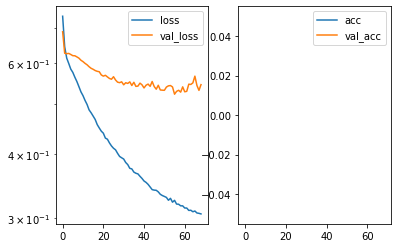

Predicted cell: Landmark Probability: [[0.9967614]]
True Cell type: Landmark
x [[0.6030621]]
True positional value x 0.578125
y [[0.34920684]]
True positional value y 0.5


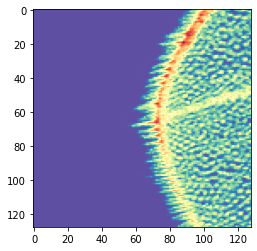

Epoch 70/250
2656/2656 [==============================] - 13s 5ms/step - loss: 0.3045 - accuracy: 0.9947 - val_loss: 0.5306 - val_accuracy: 0.9071

Epoch 00070: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5305734553507396, 'val_accuracy': 0.9071428775787354, 'loss': 0.30452814343643475, 'accuracy': 0.9947289, 'lr': 1e-06}


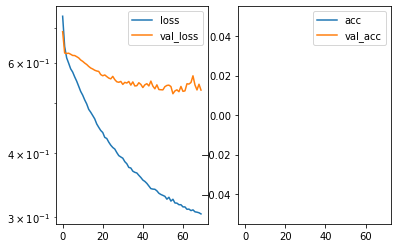

Predicted cell: Landmark Probability: [[0.85776955]]
True Cell type: Landmark
x [[0.3338192]]
True positional value x 0.5
y [[0.36854625]]
True positional value y 0.421875


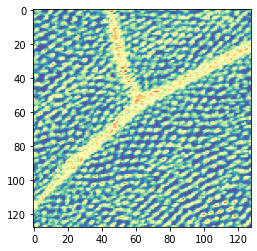

Epoch 71/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.3040 - accuracy: 0.9955 - val_loss: 0.5368 - val_accuracy: 0.9071

Epoch 00071: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5368383207491466, 'val_accuracy': 0.9071428775787354, 'loss': 0.30403998925025205, 'accuracy': 0.9954819, 'lr': 1e-06}


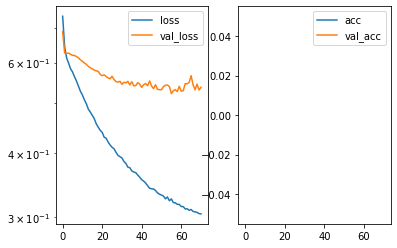

Predicted cell: Landmark Probability: [[0.993435]]
True Cell type: Landmark
x [[0.3537149]]
True positional value x 0.421875
y [[0.48544854]]
True positional value y 0.5


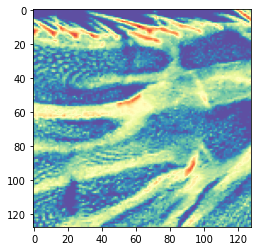

Epoch 72/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.3029 - accuracy: 0.9944 - val_loss: 0.5308 - val_accuracy: 0.9071

Epoch 00072: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5308475898844855, 'val_accuracy': 0.9071428775787354, 'loss': 0.3029165256050337, 'accuracy': 0.9943524, 'lr': 1e-06}


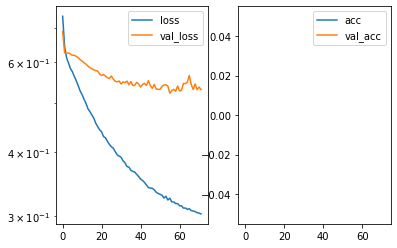

Predicted cell: Landmark Probability: [[0.9992054]]
True Cell type: Landmark
x [[0.30780515]]
True positional value x 0.5
y [[0.6578084]]
True positional value y 0.5


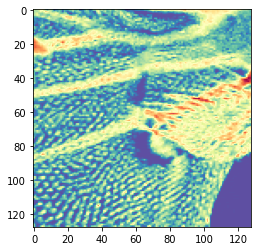

Epoch 73/250
2656/2656 [==============================] - 12s 4ms/step - loss: 0.2999 - accuracy: 0.9974 - val_loss: 0.5359 - val_accuracy: 0.9071

Epoch 00073: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5358646639755794, 'val_accuracy': 0.9071428775787354, 'loss': 0.29994796934616136, 'accuracy': 0.99736446, 'lr': 1e-06}


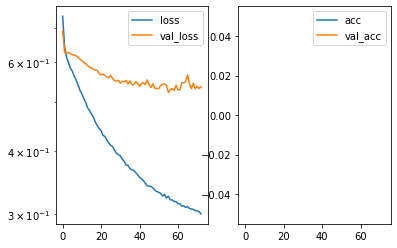

Predicted cell: Landmark Probability: [[0.97828156]]
True Cell type: Landmark
x [[0.2827342]]
True positional value x 0.5
y [[0.36564174]]
True positional value y 0.421875


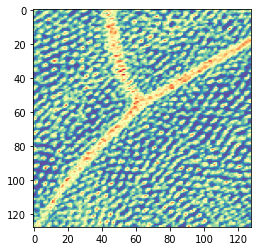

Epoch 74/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.3001 - accuracy: 0.9974 - val_loss: 0.5282 - val_accuracy: 0.9071

Epoch 00074: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5281886628695897, 'val_accuracy': 0.9071428775787354, 'loss': 0.30011679362281257, 'accuracy': 0.99736446, 'lr': 1e-06}


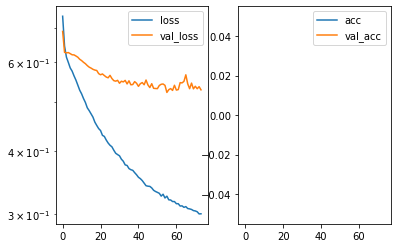

Predicted cell: Landmark Probability: [[0.9779644]]
True Cell type: Landmark
x [[0.5957402]]
True positional value x 0.5
y [[0.39356518]]
True positional value y 0.578125


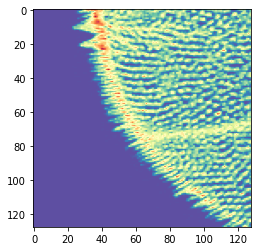

Epoch 75/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2993 - accuracy: 0.9966 - val_loss: 0.5356 - val_accuracy: 0.9071

Epoch 00075: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5356403525386538, 'val_accuracy': 0.9071428775787354, 'loss': 0.2992995672421642, 'accuracy': 0.9966114, 'lr': 1e-06}


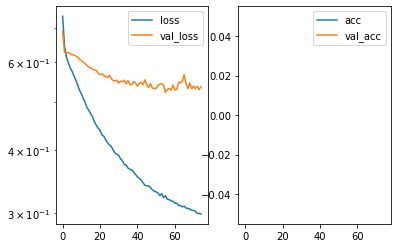

Predicted cell: Landmark Probability: [[0.99924856]]
True Cell type: Landmark
x [[0.3401825]]
True positional value x 0.5
y [[0.2735603]]
True positional value y 0.421875


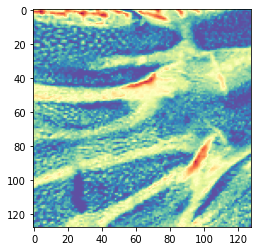

Epoch 76/250
2656/2656 [==============================] - 13s 5ms/step - loss: 0.2972 - accuracy: 0.9985 - val_loss: 0.5495 - val_accuracy: 0.9071

Epoch 00076: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5495273875338691, 'val_accuracy': 0.9071428775787354, 'loss': 0.2972258979746376, 'accuracy': 0.99849397, 'lr': 1e-06}


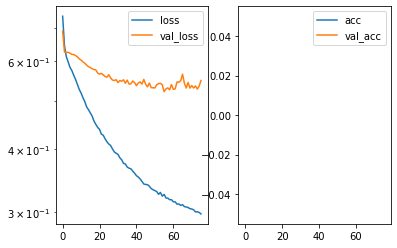

Predicted cell: Landmark Probability: [[0.9434955]]
True Cell type: Background
x [[0.71677685]]
True positional value x 0.5
y [[0.19276027]]
True positional value y 0.5


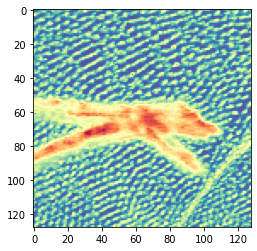

Epoch 77/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2984 - accuracy: 0.9977 - val_loss: 0.5412 - val_accuracy: 0.9071

Epoch 00077: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5411665907927922, 'val_accuracy': 0.9071428775787354, 'loss': 0.2984183753604989, 'accuracy': 0.997741, 'lr': 1e-06}


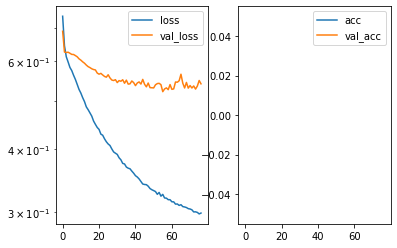

Predicted cell: Landmark Probability: [[0.9380391]]
True Cell type: Landmark
x [[0.47790712]]
True positional value x 0.578125
y [[0.60580295]]
True positional value y 0.421875


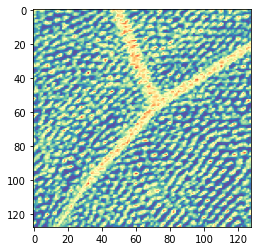

Epoch 78/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2960 - accuracy: 0.9977 - val_loss: 0.5449 - val_accuracy: 0.9071

Epoch 00078: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.544921515243394, 'val_accuracy': 0.9071428775787354, 'loss': 0.29599775618548135, 'accuracy': 0.997741, 'lr': 1e-06}


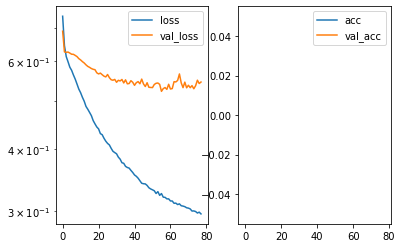

Predicted cell: Landmark Probability: [[0.8931646]]
True Cell type: Landmark
x [[0.39999032]]
True positional value x 0.5
y [[0.3712445]]
True positional value y 0.578125


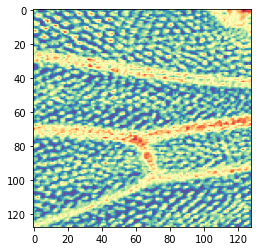

Epoch 79/250
2656/2656 [==============================] - 12s 4ms/step - loss: 0.2948 - accuracy: 0.9985 - val_loss: 0.5424 - val_accuracy: 0.9071

Epoch 00079: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5424316929919379, 'val_accuracy': 0.9071428775787354, 'loss': 0.2947605992386858, 'accuracy': 0.99849397, 'lr': 1e-06}


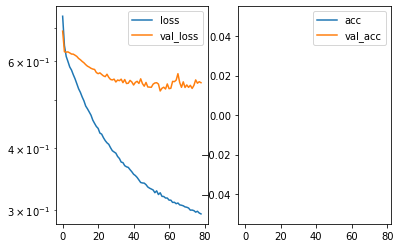

Predicted cell: Landmark Probability: [[0.9351045]]
True Cell type: Background
x [[0.39972088]]
True positional value x 0.5
y [[0.33009115]]
True positional value y 0.5


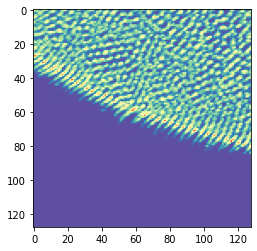

Epoch 80/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2949 - accuracy: 0.9977 - val_loss: 0.5360 - val_accuracy: 0.9071

Epoch 00080: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5359606593847275, 'val_accuracy': 0.9071428775787354, 'loss': 0.2948670423623309, 'accuracy': 0.997741, 'lr': 1e-06}


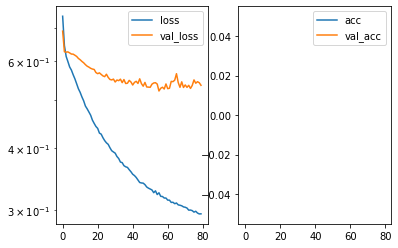

Predicted cell: Landmark Probability: [[0.9873964]]
True Cell type: Landmark
x [[0.79224074]]
True positional value x 0.5
y [[0.45709932]]
True positional value y 0.578125


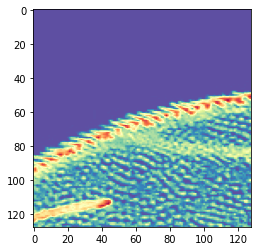

Epoch 81/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2938 - accuracy: 0.9989 - val_loss: 0.5343 - val_accuracy: 0.9071

Epoch 00081: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5342911056109837, 'val_accuracy': 0.9071428775787354, 'loss': 0.29382631734731685, 'accuracy': 0.9988705, 'lr': 1e-06}


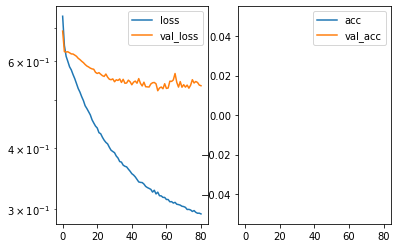

Predicted cell: Landmark Probability: [[0.99606675]]
True Cell type: Landmark
x [[0.72130144]]
True positional value x 0.421875
y [[0.41851836]]
True positional value y 0.578125


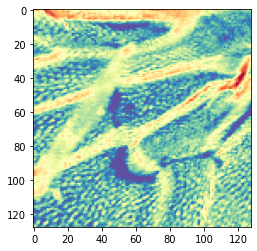

Epoch 82/250
2656/2656 [==============================] - 12s 4ms/step - loss: 0.2940 - accuracy: 0.9974 - val_loss: 0.5338 - val_accuracy: 0.9071

Epoch 00082: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5337929406336376, 'val_accuracy': 0.9071428775787354, 'loss': 0.2940041646136936, 'accuracy': 0.99736446, 'lr': 1e-06}


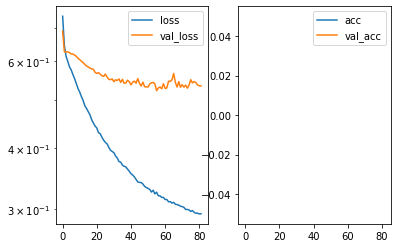

Predicted cell: Landmark Probability: [[0.9686405]]
True Cell type: Landmark
x [[0.35358927]]
True positional value x 0.5
y [[0.49247903]]
True positional value y 0.5


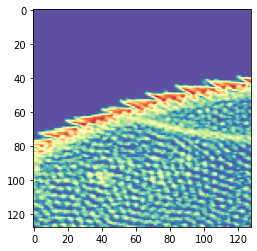

Epoch 83/250
2656/2656 [==============================] - 12s 5ms/step - loss: 0.2929 - accuracy: 0.9974 - val_loss: 0.5421 - val_accuracy: 0.9071

Epoch 00083: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5421253102166312, 'val_accuracy': 0.9071428775787354, 'loss': 0.29288408135523997, 'accuracy': 0.99736446, 'lr': 1e-06}


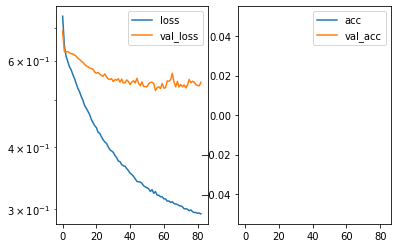

Predicted cell: Landmark Probability: [[0.9968183]]
True Cell type: Landmark
x [[0.4920351]]
True positional value x 0.578125
y [[0.70816624]]
True positional value y 0.421875


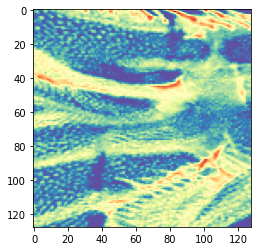

Epoch 84/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2921 - accuracy: 0.9977 - val_loss: 0.5403 - val_accuracy: 0.9071

Epoch 00084: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5403260248047965, 'val_accuracy': 0.9071428775787354, 'loss': 0.29208419476467445, 'accuracy': 0.997741, 'lr': 1e-06}


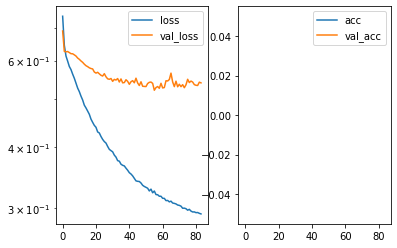

Predicted cell: Landmark Probability: [[0.99091184]]
True Cell type: Landmark
x [[0.830386]]
True positional value x 0.578125
y [[0.36538455]]
True positional value y 0.421875


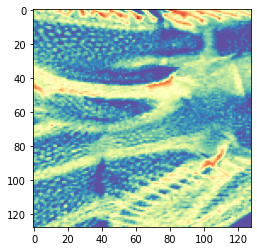

Epoch 85/250
2656/2656 [==============================] - 12s 4ms/step - loss: 0.2925 - accuracy: 0.9985 - val_loss: 0.5282 - val_accuracy: 0.9143

Epoch 00085: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5281585816826139, 'val_accuracy': 0.9142857193946838, 'loss': 0.2925279844462512, 'accuracy': 0.99849397, 'lr': 1e-06}


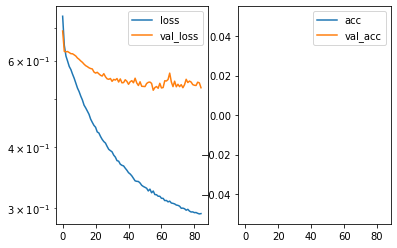

Predicted cell: Landmark Probability: [[0.9904683]]
True Cell type: Landmark
x [[0.32378128]]
True positional value x 0.5
y [[0.18810095]]
True positional value y 0.421875


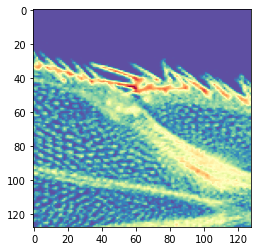

Epoch 86/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2918 - accuracy: 0.9996 - val_loss: 0.5392 - val_accuracy: 0.9071

Epoch 00086: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5392081333058221, 'val_accuracy': 0.9071428775787354, 'loss': 0.29181708067835094, 'accuracy': 0.9996235, 'lr': 1e-06}


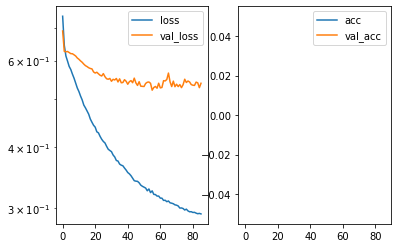

Predicted cell: Landmark Probability: [[0.99772817]]
True Cell type: Landmark
x [[0.3901232]]
True positional value x 0.421875
y [[0.68351185]]
True positional value y 0.578125


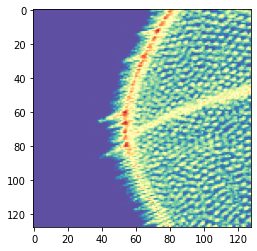

Epoch 87/250
2656/2656 [==============================] - 13s 5ms/step - loss: 0.2907 - accuracy: 0.9981 - val_loss: 0.5392 - val_accuracy: 0.9071

Epoch 00087: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.539179156933512, 'val_accuracy': 0.9071428775787354, 'loss': 0.29068925496504966, 'accuracy': 0.99811745, 'lr': 1e-06}


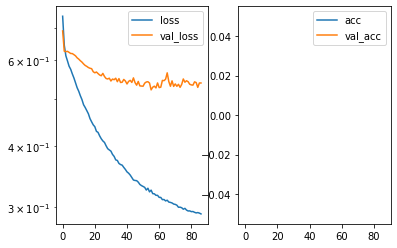

Predicted cell: Landmark Probability: [[0.9930507]]
True Cell type: Landmark
x [[0.41998973]]
True positional value x 0.5
y [[0.62047493]]
True positional value y 0.5


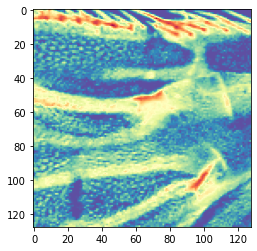

Epoch 88/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2890 - accuracy: 0.9985 - val_loss: 0.5417 - val_accuracy: 0.9071

Epoch 00088: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.541726352913039, 'val_accuracy': 0.9071428775787354, 'loss': 0.2890443787292903, 'accuracy': 0.99849397, 'lr': 1e-06}


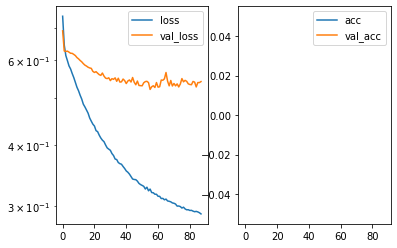

Predicted cell: Landmark Probability: [[0.9967006]]
True Cell type: Landmark
x [[0.67827624]]
True positional value x 0.421875
y [[0.38296187]]
True positional value y 0.578125


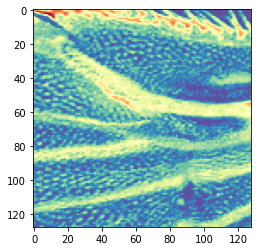

Epoch 89/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2884 - accuracy: 0.9985 - val_loss: 0.5454 - val_accuracy: 0.9071

Epoch 00089: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.545371732541493, 'val_accuracy': 0.9071428775787354, 'loss': 0.28840285853808184, 'accuracy': 0.99849397, 'lr': 1e-06}


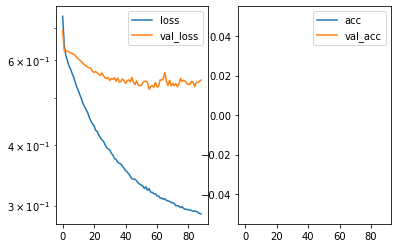

Predicted cell: Landmark Probability: [[0.98700935]]
True Cell type: Landmark
x [[0.28590947]]
True positional value x 0.5
y [[0.41545475]]
True positional value y 0.421875


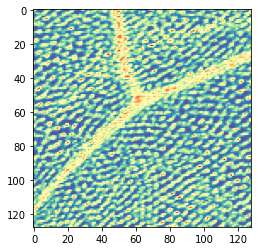

Epoch 90/250
2656/2656 [==============================] - 13s 5ms/step - loss: 0.2883 - accuracy: 0.9989 - val_loss: 0.5586 - val_accuracy: 0.9071

Epoch 00090: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.558564326592854, 'val_accuracy': 0.9071428775787354, 'loss': 0.2882581270153982, 'accuracy': 0.9988705, 'lr': 1e-06}


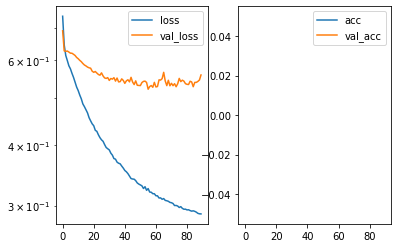

Predicted cell: Landmark Probability: [[0.96203196]]
True Cell type: Landmark
x [[0.37402406]]
True positional value x 0.5
y [[0.6215582]]
True positional value y 0.578125


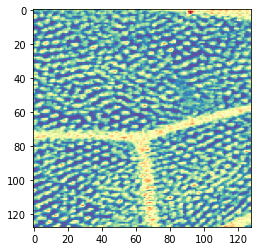

Epoch 91/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2881 - accuracy: 0.9989 - val_loss: 0.5540 - val_accuracy: 0.9071

Epoch 00091: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5539884290524891, 'val_accuracy': 0.9071428775787354, 'loss': 0.2880554408149188, 'accuracy': 0.9988705, 'lr': 1e-06}


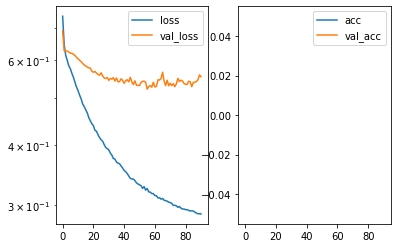

Predicted cell: Landmark Probability: [[0.99711204]]
True Cell type: Landmark
x [[0.26253608]]
True positional value x 0.421875
y [[0.6439947]]
True positional value y 0.421875


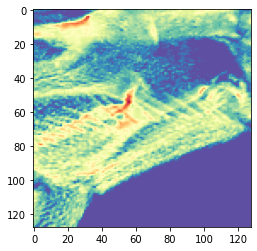

Epoch 92/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2866 - accuracy: 0.9996 - val_loss: 0.5447 - val_accuracy: 0.9071

Epoch 00092: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5447412431240082, 'val_accuracy': 0.9071428775787354, 'loss': 0.2866159347390913, 'accuracy': 0.9996235, 'lr': 1e-06}


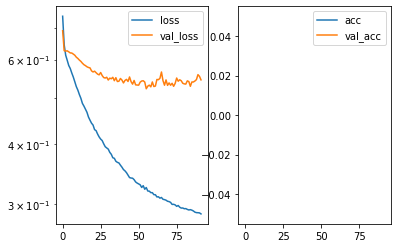

Predicted cell: Landmark Probability: [[0.96620286]]
True Cell type: Landmark
x [[0.73985624]]
True positional value x 0.578125
y [[0.76857305]]
True positional value y 0.421875


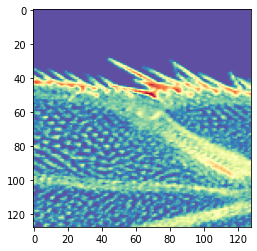

Epoch 93/250
2656/2656 [==============================] - 12s 5ms/step - loss: 0.2863 - accuracy: 0.9989 - val_loss: 0.5370 - val_accuracy: 0.9071

Epoch 00093: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5369827555758613, 'val_accuracy': 0.9071428775787354, 'loss': 0.28634887323322067, 'accuracy': 0.9988705, 'lr': 1e-06}


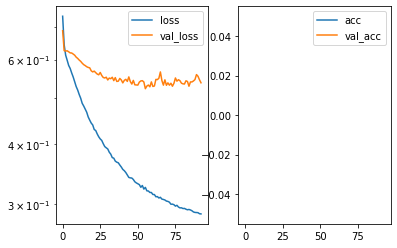

Predicted cell: Landmark Probability: [[0.9166548]]
True Cell type: Landmark
x [[0.32155195]]
True positional value x 0.5
y [[0.45500517]]
True positional value y 0.578125


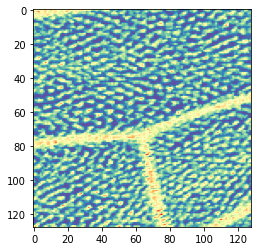

Epoch 94/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2878 - accuracy: 0.9992 - val_loss: 0.5419 - val_accuracy: 0.9071

Epoch 00094: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5419305371386665, 'val_accuracy': 0.9071428775787354, 'loss': 0.28781913393682024, 'accuracy': 0.999247, 'lr': 1e-06}


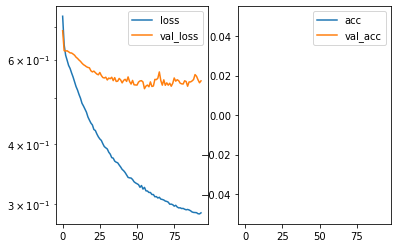

Predicted cell: Landmark Probability: [[0.9976629]]
True Cell type: Landmark
x [[0.3410565]]
True positional value x 0.421875
y [[0.6967312]]
True positional value y 0.578125


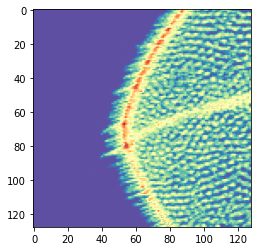

Epoch 95/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2856 - accuracy: 0.9996 - val_loss: 0.5454 - val_accuracy: 0.9071

Epoch 00095: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5454057327338627, 'val_accuracy': 0.9071428775787354, 'loss': 0.2856078594025359, 'accuracy': 0.9996235, 'lr': 1e-06}


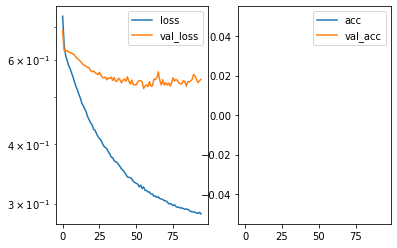

Predicted cell: Landmark Probability: [[0.99969745]]
True Cell type: Landmark
x [[0.51171184]]
True positional value x 0.5
y [[0.5942478]]
True positional value y 0.421875


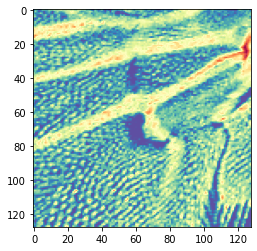

Epoch 96/250
2656/2656 [==============================] - 12s 5ms/step - loss: 0.2867 - accuracy: 0.9989 - val_loss: 0.5532 - val_accuracy: 0.9071

Epoch 00096: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5532470451933997, 'val_accuracy': 0.9071428775787354, 'loss': 0.2866582613528134, 'accuracy': 0.9988705, 'lr': 1e-06}


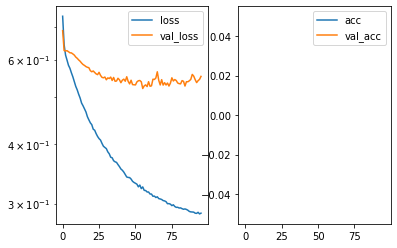

Predicted cell: Landmark Probability: [[0.9980579]]
True Cell type: Landmark
x [[0.53521043]]
True positional value x 0.421875
y [[0.5549349]]
True positional value y 0.578125


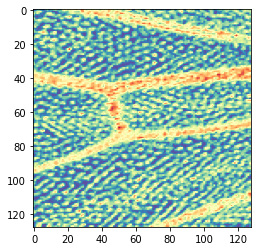

Epoch 97/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2850 - accuracy: 0.9992 - val_loss: 0.5435 - val_accuracy: 0.9071

Epoch 00097: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5434822759457997, 'val_accuracy': 0.9071428775787354, 'loss': 0.2849835162780371, 'accuracy': 0.999247, 'lr': 1e-06}


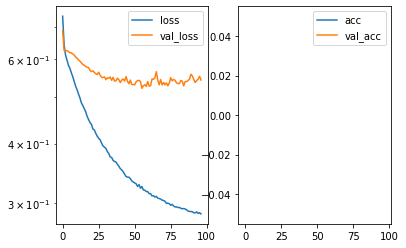

Predicted cell: Landmark Probability: [[0.9861637]]
True Cell type: Landmark
x [[0.5455869]]
True positional value x 0.421875
y [[0.24642834]]
True positional value y 0.421875


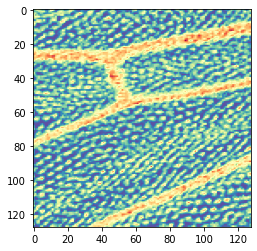

Epoch 98/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2843 - accuracy: 0.9996 - val_loss: 0.5416 - val_accuracy: 0.9071

Epoch 00098: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5415766196591514, 'val_accuracy': 0.9071428775787354, 'loss': 0.28430783793509723, 'accuracy': 0.9996235, 'lr': 1e-06}


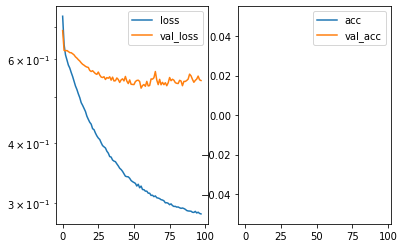

Predicted cell: Landmark Probability: [[0.9942842]]
True Cell type: Landmark
x [[0.60666066]]
True positional value x 0.5
y [[0.65142435]]
True positional value y 0.578125


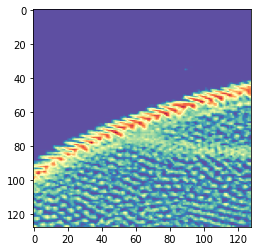

Epoch 99/250
2656/2656 [==============================] - 12s 4ms/step - loss: 0.2848 - accuracy: 0.9989 - val_loss: 0.5413 - val_accuracy: 0.9071

Epoch 00099: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5413362703153065, 'val_accuracy': 0.9071428775787354, 'loss': 0.2847637507211731, 'accuracy': 0.9988705, 'lr': 1e-06}


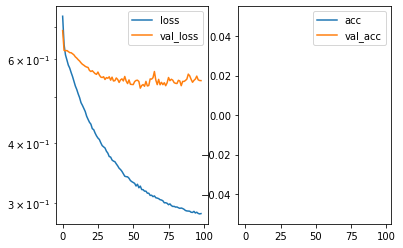

Predicted cell: Landmark Probability: [[0.99761474]]
True Cell type: Landmark
x [[0.62649345]]
True positional value x 0.578125
y [[0.47959524]]
True positional value y 0.578125


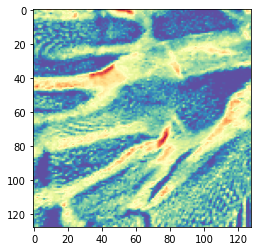

Epoch 100/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2845 - accuracy: 0.9985 - val_loss: 0.5492 - val_accuracy: 0.9071

Epoch 00100: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.549159973859787, 'val_accuracy': 0.9071428775787354, 'loss': 0.284533451232745, 'accuracy': 0.99849397, 'lr': 1e-06}


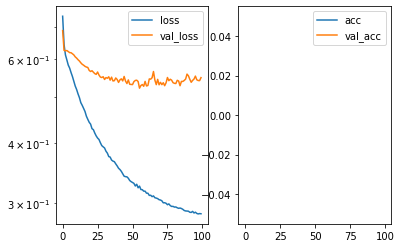

Predicted cell: Landmark Probability: [[0.9992605]]
True Cell type: Landmark
x [[0.38883543]]
True positional value x 0.5
y [[0.5340941]]
True positional value y 0.578125


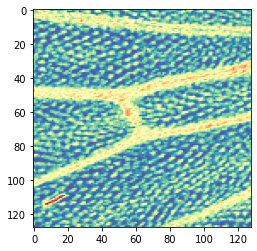

Epoch 101/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2835 - accuracy: 0.9996 - val_loss: 0.5370 - val_accuracy: 0.9143

Epoch 00101: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5369502156972885, 'val_accuracy': 0.9142857193946838, 'loss': 0.28345558958419836, 'accuracy': 0.9996235, 'lr': 1e-06}


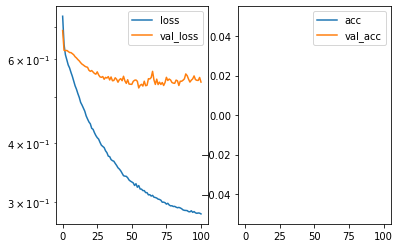

Predicted cell: Landmark Probability: [[0.9985942]]
True Cell type: Landmark
x [[0.40809554]]
True positional value x 0.421875
y [[0.36141393]]
True positional value y 0.578125


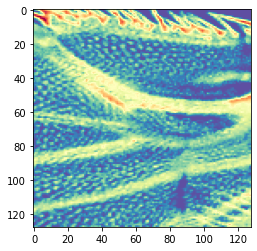

Epoch 102/250
2656/2656 [==============================] - 12s 4ms/step - loss: 0.2824 - accuracy: 0.9992 - val_loss: 0.5418 - val_accuracy: 0.9071

Epoch 00102: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5418222376278469, 'val_accuracy': 0.9071428775787354, 'loss': 0.28244476664407425, 'accuracy': 0.999247, 'lr': 1e-06}


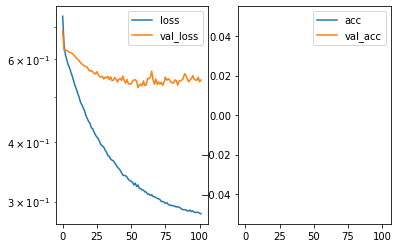

Predicted cell: Landmark Probability: [[0.9763534]]
True Cell type: Landmark
x [[0.43023965]]
True positional value x 0.421875
y [[0.4248067]]
True positional value y 0.5


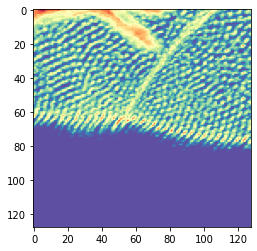

Epoch 103/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2828 - accuracy: 0.9992 - val_loss: 0.5344 - val_accuracy: 0.9143

Epoch 00103: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5344151492629733, 'val_accuracy': 0.9142857193946838, 'loss': 0.2827532609184104, 'accuracy': 0.999247, 'lr': 1e-06}


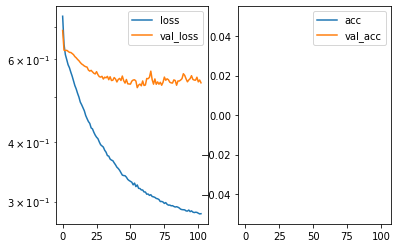

Predicted cell: Landmark Probability: [[0.9505377]]
True Cell type: Landmark
x [[0.37039548]]
True positional value x 0.5
y [[0.646541]]
True positional value y 0.578125


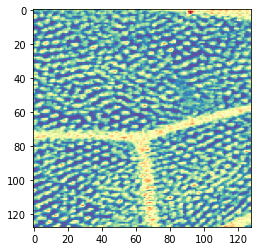

Epoch 104/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2823 - accuracy: 0.9996 - val_loss: 0.5502 - val_accuracy: 0.9071

Epoch 00104: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5502280763217381, 'val_accuracy': 0.9071428775787354, 'loss': 0.2822817799422037, 'accuracy': 0.9996235, 'lr': 1e-06}


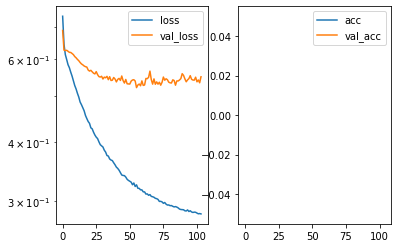

Predicted cell: Landmark Probability: [[0.99501944]]
True Cell type: Landmark
x [[0.31480756]]
True positional value x 0.5
y [[0.19750144]]
True positional value y 0.421875


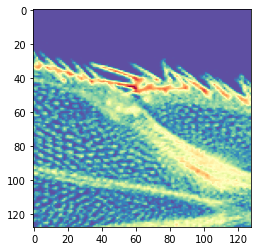

Epoch 105/250
2656/2656 [==============================] - 12s 4ms/step - loss: 0.2811 - accuracy: 0.9996 - val_loss: 0.5497 - val_accuracy: 0.9071

Epoch 00105: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5496600525719779, 'val_accuracy': 0.9071428775787354, 'loss': 0.2811126193727355, 'accuracy': 0.9996235, 'lr': 1e-06}


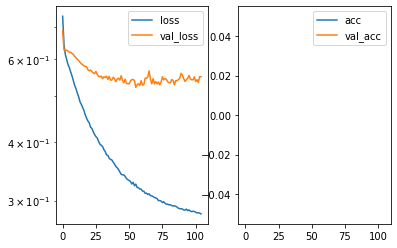

Predicted cell: Landmark Probability: [[0.9804859]]
True Cell type: Landmark
x [[0.4887696]]
True positional value x 0.421875
y [[0.46492788]]
True positional value y 0.578125


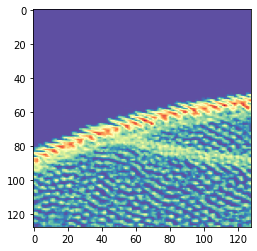

Epoch 106/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2819 - accuracy: 0.9985 - val_loss: 0.5370 - val_accuracy: 0.9143

Epoch 00106: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5370064952543804, 'val_accuracy': 0.9142857193946838, 'loss': 0.28186240875308055, 'accuracy': 0.99849397, 'lr': 1e-06}


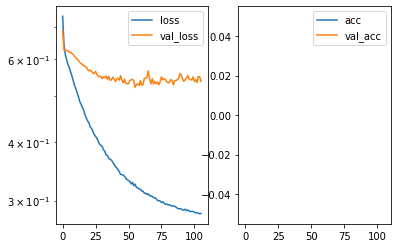

Predicted cell: Landmark Probability: [[0.9858499]]
True Cell type: Landmark
x [[0.59940636]]
True positional value x 0.5
y [[0.38113037]]
True positional value y 0.578125


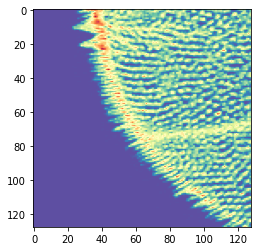

Epoch 107/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2802 - accuracy: 1.0000 - val_loss: 0.5465 - val_accuracy: 0.9071

Epoch 00107: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5464762513126645, 'val_accuracy': 0.9071428775787354, 'loss': 0.28015994278332557, 'accuracy': 1.0, 'lr': 1e-06}


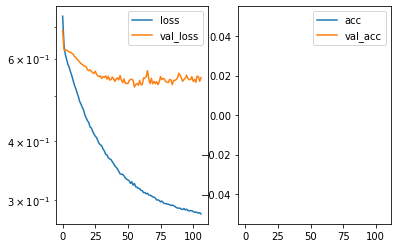

Predicted cell: Landmark Probability: [[0.98071575]]
True Cell type: Landmark
x [[0.6221047]]
True positional value x 0.421875
y [[0.49018314]]
True positional value y 0.578125


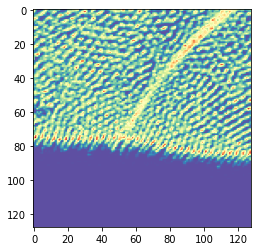

Epoch 108/250
2656/2656 [==============================] - 12s 4ms/step - loss: 0.2808 - accuracy: 0.9996 - val_loss: 0.5607 - val_accuracy: 0.9071

Epoch 00108: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5607174294335502, 'val_accuracy': 0.9071428775787354, 'loss': 0.2807645671608218, 'accuracy': 0.9996235, 'lr': 1e-06}


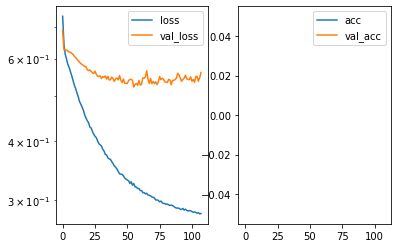

Predicted cell: Landmark Probability: [[0.99895585]]
True Cell type: Landmark
x [[0.5926967]]
True positional value x 0.421875
y [[0.41414836]]
True positional value y 0.421875


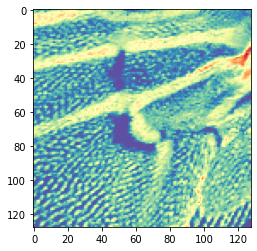

Epoch 109/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2793 - accuracy: 1.0000 - val_loss: 0.5536 - val_accuracy: 0.9071

Epoch 00109: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5536163789885384, 'val_accuracy': 0.9071428775787354, 'loss': 0.27934902969254066, 'accuracy': 1.0, 'lr': 1e-06}


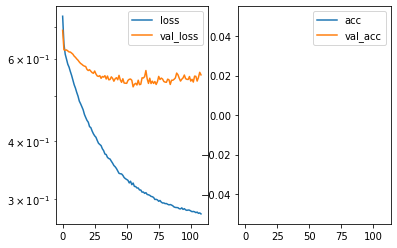

Predicted cell: Landmark Probability: [[0.994899]]
True Cell type: Landmark
x [[0.6608953]]
True positional value x 0.578125
y [[0.63834435]]
True positional value y 0.5


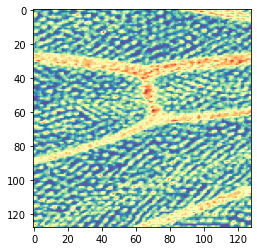

Epoch 110/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2803 - accuracy: 0.9996 - val_loss: 0.5582 - val_accuracy: 0.9071

Epoch 00110: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5582364627293178, 'val_accuracy': 0.9071428775787354, 'loss': 0.28027891143258793, 'accuracy': 0.9996235, 'lr': 1e-06}


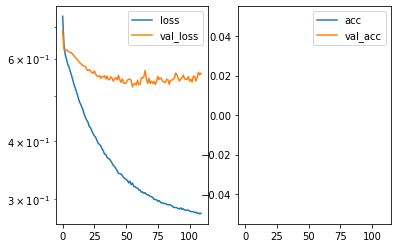

Predicted cell: Landmark Probability: [[0.96027535]]
True Cell type: Landmark
x [[0.49527282]]
True positional value x 0.5
y [[0.4484967]]
True positional value y 0.5


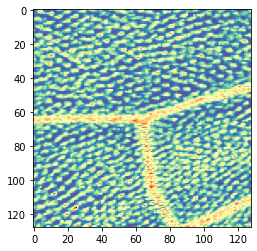

Epoch 111/250
2656/2656 [==============================] - 13s 5ms/step - loss: 0.2801 - accuracy: 0.9996 - val_loss: 0.5310 - val_accuracy: 0.9143

Epoch 00111: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5310448003666741, 'val_accuracy': 0.9142857193946838, 'loss': 0.28008125587759247, 'accuracy': 0.9996235, 'lr': 1e-06}


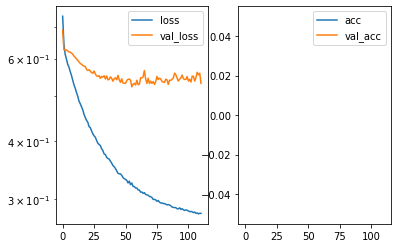

Predicted cell: Landmark Probability: [[0.9994966]]
True Cell type: Landmark
x [[0.351621]]
True positional value x 0.5
y [[0.15146104]]
True positional value y 0.421875


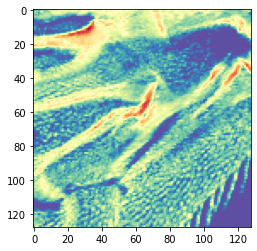

Epoch 112/250
2656/2656 [==============================] - 12s 4ms/step - loss: 0.2798 - accuracy: 1.0000 - val_loss: 0.5442 - val_accuracy: 0.9143

Epoch 00112: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5441780005182538, 'val_accuracy': 0.9142857193946838, 'loss': 0.2797753450696368, 'accuracy': 1.0, 'lr': 1e-06}


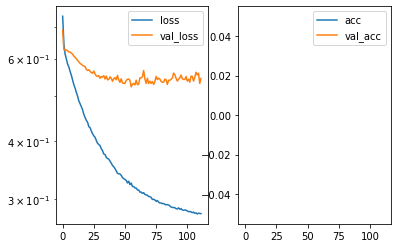

Predicted cell: Landmark Probability: [[0.9914165]]
True Cell type: Landmark
x [[0.5402477]]
True positional value x 0.578125
y [[0.49195904]]
True positional value y 0.421875


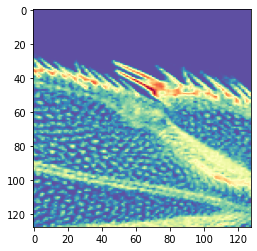

Epoch 113/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2798 - accuracy: 0.9989 - val_loss: 0.5561 - val_accuracy: 0.9071

Epoch 00113: ReduceLROnPlateau reducing learning rate to 9.999999974752428e-08.

Epoch 00113: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5560639266456876, 'val_accuracy': 0.9071428775787354, 'loss': 0.27981147876974327, 'accuracy': 0.9988705, 'lr': 1e-06}


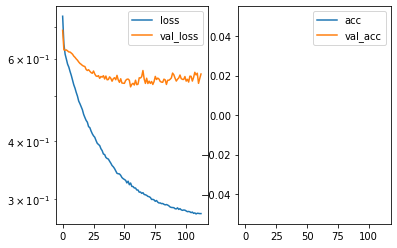

Predicted cell: Landmark Probability: [[0.99713683]]
True Cell type: Landmark
x [[0.4207152]]
True positional value x 0.5
y [[0.46208134]]
True positional value y 0.5


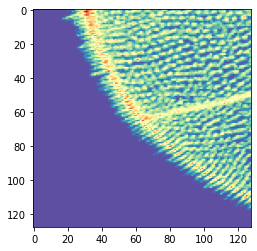

Epoch 114/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2796 - accuracy: 0.9996 - val_loss: 0.5543 - val_accuracy: 0.9071

Epoch 00114: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5542500487395695, 'val_accuracy': 0.9071428775787354, 'loss': 0.27955548438322114, 'accuracy': 0.9996235, 'lr': 1e-07}


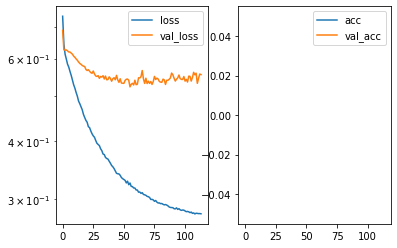

Predicted cell: Landmark Probability: [[0.99983406]]
True Cell type: Landmark
x [[0.5663072]]
True positional value x 0.5
y [[0.6738]]
True positional value y 0.421875


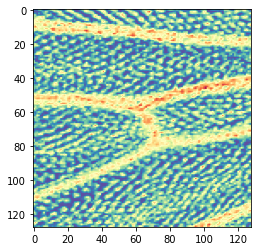

Epoch 115/250
2656/2656 [==============================] - 13s 5ms/step - loss: 0.2798 - accuracy: 0.9989 - val_loss: 0.5483 - val_accuracy: 0.9071

Epoch 00115: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5483413253511701, 'val_accuracy': 0.9071428775787354, 'loss': 0.27984048248863364, 'accuracy': 0.9988705, 'lr': 1e-07}


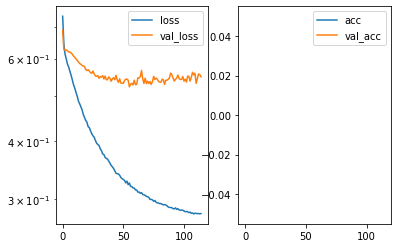

Predicted cell: Landmark Probability: [[0.8733631]]
True Cell type: Background
x [[0.5955638]]
True positional value x 0.5
y [[0.6402516]]
True positional value y 0.5


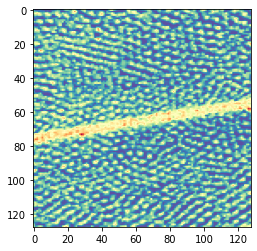

Epoch 116/250
2656/2656 [==============================] - 12s 5ms/step - loss: 0.2799 - accuracy: 0.9977 - val_loss: 0.5470 - val_accuracy: 0.9143

Epoch 00116: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5470272174903325, 'val_accuracy': 0.9142857193946838, 'loss': 0.27994030146264887, 'accuracy': 0.997741, 'lr': 1e-07}


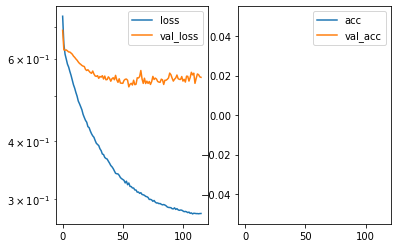

Predicted cell: Landmark Probability: [[0.99554944]]
True Cell type: Landmark
x [[0.82444775]]
True positional value x 0.578125
y [[0.37944365]]
True positional value y 0.421875


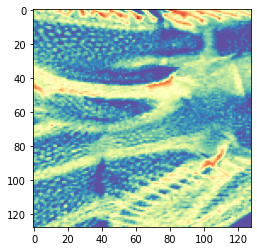

Epoch 117/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2790 - accuracy: 0.9992 - val_loss: 0.5483 - val_accuracy: 0.9143

Epoch 00117: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5483124128409794, 'val_accuracy': 0.9142857193946838, 'loss': 0.2790104539683425, 'accuracy': 0.999247, 'lr': 1e-07}


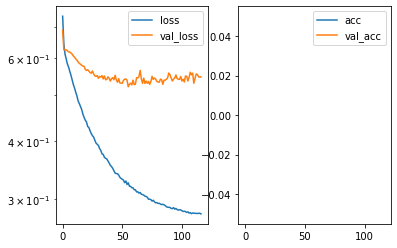

Predicted cell: Landmark Probability: [[0.99962366]]
True Cell type: Landmark
x [[0.15544803]]
True positional value x 0.421875
y [[0.5377706]]
True positional value y 0.421875


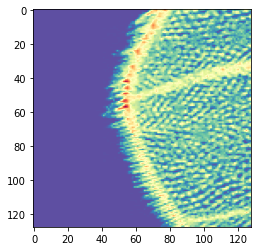

Epoch 118/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2773 - accuracy: 1.0000 - val_loss: 0.5497 - val_accuracy: 0.9143

Epoch 00118: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5496915791715894, 'val_accuracy': 0.9142857193946838, 'loss': 0.2772938614958022, 'accuracy': 1.0, 'lr': 1e-07}


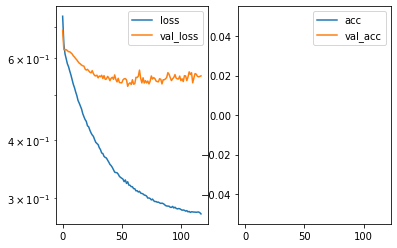

Predicted cell: Landmark Probability: [[0.95993435]]
True Cell type: Landmark
x [[0.32217956]]
True positional value x 0.5
y [[0.4040101]]
True positional value y 0.5


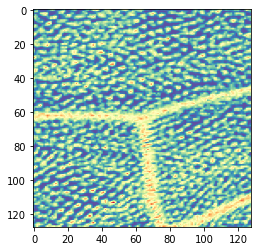

Epoch 119/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2787 - accuracy: 1.0000 - val_loss: 0.5482 - val_accuracy: 0.9143

Epoch 00119: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5481992896114077, 'val_accuracy': 0.9142857193946838, 'loss': 0.2787278975214226, 'accuracy': 1.0, 'lr': 1e-07}


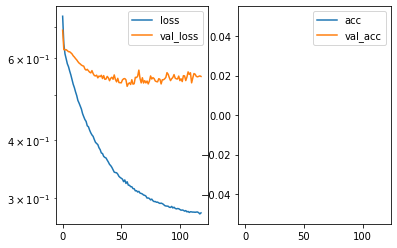

Predicted cell: Landmark Probability: [[0.99972004]]
True Cell type: Landmark
x [[0.30129534]]
True positional value x 0.5
y [[0.64361835]]
True positional value y 0.5


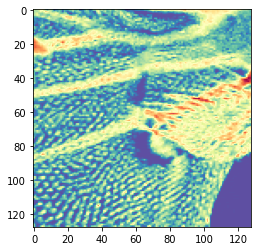

Epoch 120/250
2656/2656 [==============================] - 16s 6ms/step - loss: 0.2782 - accuracy: 0.9996 - val_loss: 0.5495 - val_accuracy: 0.9143

Epoch 00120: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5494830459356308, 'val_accuracy': 0.9142857193946838, 'loss': 0.27819184671683483, 'accuracy': 0.9996235, 'lr': 1e-07}


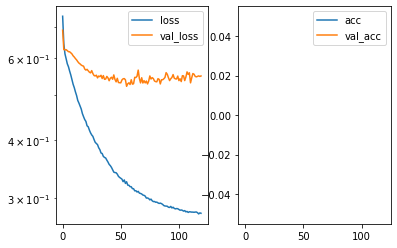

Predicted cell: Landmark Probability: [[0.7835141]]
True Cell type: Landmark
x [[0.30587035]]
True positional value x 0.578125
y [[0.55575764]]
True positional value y 0.578125


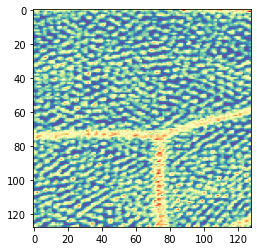

Epoch 121/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2783 - accuracy: 0.9996 - val_loss: 0.5501 - val_accuracy: 0.9143

Epoch 00121: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5501255584614617, 'val_accuracy': 0.9142857193946838, 'loss': 0.27828746515674047, 'accuracy': 0.9996235, 'lr': 1e-07}


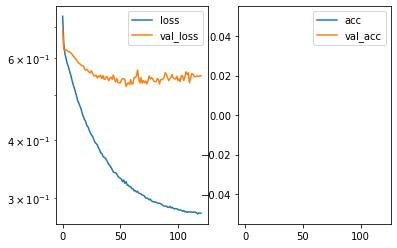

Predicted cell: Landmark Probability: [[0.97185564]]
True Cell type: Landmark
x [[0.6287756]]
True positional value x 0.5
y [[0.48861814]]
True positional value y 0.578125


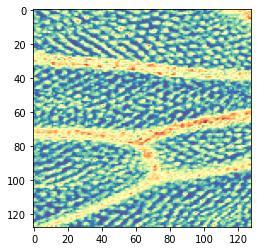

Epoch 122/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2778 - accuracy: 1.0000 - val_loss: 0.5508 - val_accuracy: 0.9143

Epoch 00122: ReduceLROnPlateau reducing learning rate to 1.0000000116860975e-08.

Epoch 00122: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5508020945957729, 'val_accuracy': 0.9142857193946838, 'loss': 0.27780718612204114, 'accuracy': 1.0, 'lr': 1e-07}


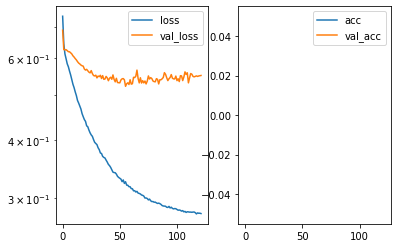

Predicted cell: Landmark Probability: [[0.99947983]]
True Cell type: Landmark
x [[0.333098]]
True positional value x 0.5
y [[0.28879142]]
True positional value y 0.5


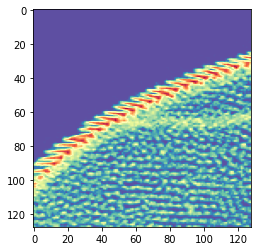

Epoch 123/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2780 - accuracy: 0.9996 - val_loss: 0.5505 - val_accuracy: 0.9143

Epoch 00123: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5505089781114033, 'val_accuracy': 0.9142857193946838, 'loss': 0.27800790442669965, 'accuracy': 0.9996235, 'lr': 1e-08}


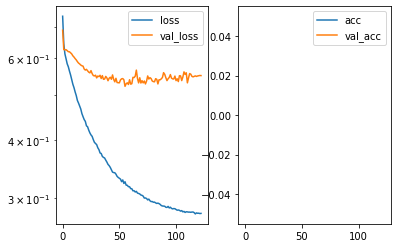

Predicted cell: Landmark Probability: [[0.9935818]]
True Cell type: Landmark
x [[0.66629386]]
True positional value x 0.5
y [[0.60086644]]
True positional value y 0.5


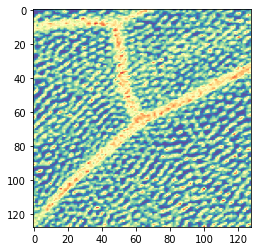

Epoch 124/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2778 - accuracy: 0.9996 - val_loss: 0.5511 - val_accuracy: 0.9143

Epoch 00124: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5511051565408707, 'val_accuracy': 0.9142857193946838, 'loss': 0.2778222705405879, 'accuracy': 0.9996235, 'lr': 1e-08}


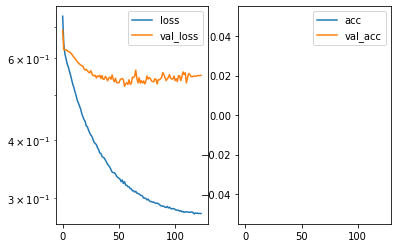

Predicted cell: Landmark Probability: [[0.9576918]]
True Cell type: Background
x [[0.6494687]]
True positional value x 0.5
y [[0.63734233]]
True positional value y 0.5


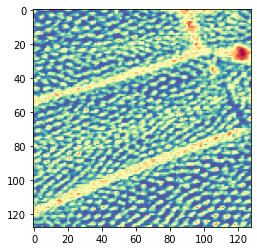

Epoch 125/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2784 - accuracy: 0.9996 - val_loss: 0.5511 - val_accuracy: 0.9143

Epoch 00125: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5511227952582496, 'val_accuracy': 0.9142857193946838, 'loss': 0.2783701000174126, 'accuracy': 0.9996235, 'lr': 1e-08}


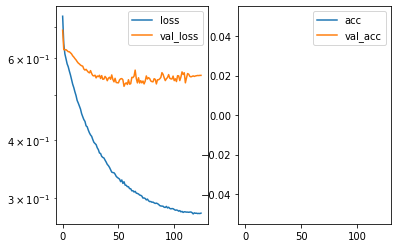

Predicted cell: Landmark Probability: [[0.99994195]]
True Cell type: Landmark
x [[0.4632655]]
True positional value x 0.578125
y [[0.5525383]]
True positional value y 0.5


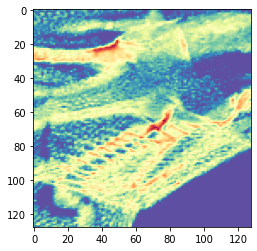

Epoch 126/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2779 - accuracy: 0.9996 - val_loss: 0.5512 - val_accuracy: 0.9143

Epoch 00126: ReduceLROnPlateau reducing learning rate to 9.999999939225292e-10.

Epoch 00126: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5511556650911059, 'val_accuracy': 0.9142857193946838, 'loss': 0.2778954203857715, 'accuracy': 0.9996235, 'lr': 1e-08}


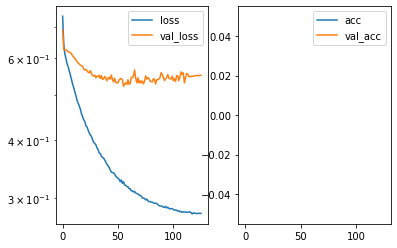

Predicted cell: Landmark Probability: [[0.9837991]]
True Cell type: Landmark
x [[0.3673626]]
True positional value x 0.5
y [[0.44710076]]
True positional value y 0.421875


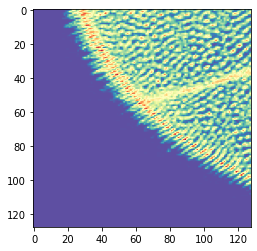

Epoch 127/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2788 - accuracy: 0.9996 - val_loss: 0.5506 - val_accuracy: 0.9143

Epoch 00127: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5505511036940983, 'val_accuracy': 0.9142857193946838, 'loss': 0.2787890597414899, 'accuracy': 0.9996235, 'lr': 1e-09}


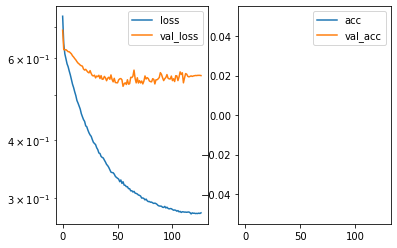

Predicted cell: Landmark Probability: [[0.9684266]]
True Cell type: Landmark
x [[0.6462266]]
True positional value x 0.578125
y [[0.47011405]]
True positional value y 0.421875


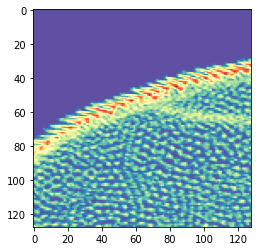

Epoch 128/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2791 - accuracy: 0.9996 - val_loss: 0.5489 - val_accuracy: 0.9143

Epoch 00128: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5488539870296206, 'val_accuracy': 0.9142857193946838, 'loss': 0.27914507536733724, 'accuracy': 0.9996235, 'lr': 1e-09}


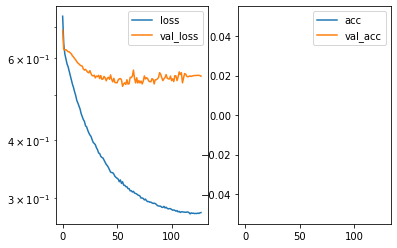

Predicted cell: Landmark Probability: [[0.99875605]]
True Cell type: Landmark
x [[0.18802373]]
True positional value x 0.421875
y [[0.45466188]]
True positional value y 0.5


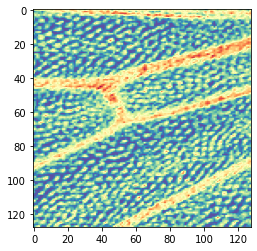

Epoch 129/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2786 - accuracy: 0.9996 - val_loss: 0.5503 - val_accuracy: 0.9143

Epoch 00129: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5502644287688392, 'val_accuracy': 0.9142857193946838, 'loss': 0.2786234788013151, 'accuracy': 0.9996235, 'lr': 1e-09}


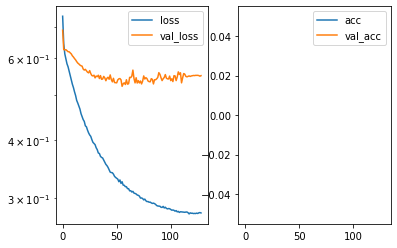

Predicted cell: Landmark Probability: [[0.99961036]]
True Cell type: Landmark
x [[0.39378554]]
True positional value x 0.578125
y [[0.35215977]]
True positional value y 0.5


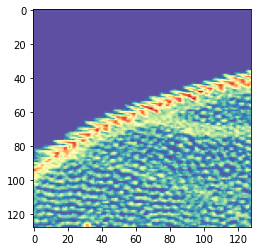

Epoch 130/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2768 - accuracy: 1.0000 - val_loss: 0.5514 - val_accuracy: 0.9143

Epoch 00130: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5514221233980996, 'val_accuracy': 0.9142857193946838, 'loss': 0.2767613405608628, 'accuracy': 1.0, 'lr': 1e-09}


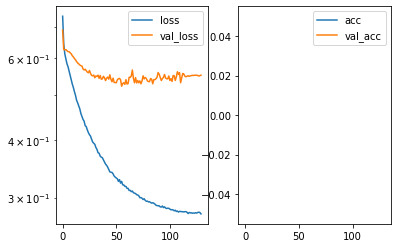

Predicted cell: Landmark Probability: [[0.9270853]]
True Cell type: Landmark
x [[0.38884845]]
True positional value x 0.5
y [[0.36876076]]
True positional value y 0.578125


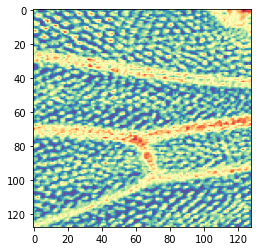

Epoch 131/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2785 - accuracy: 1.0000 - val_loss: 0.5521 - val_accuracy: 0.9143

Epoch 00131: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5521394525255475, 'val_accuracy': 0.9142857193946838, 'loss': 0.2784766747829426, 'accuracy': 1.0, 'lr': 1e-09}


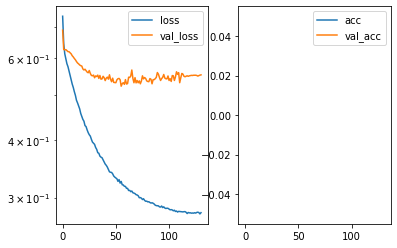

Predicted cell: Landmark Probability: [[0.957892]]
True Cell type: Background
x [[0.64761025]]
True positional value x 0.5
y [[0.6375231]]
True positional value y 0.5


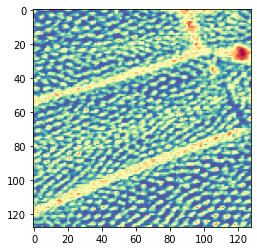

Epoch 132/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2783 - accuracy: 0.9989 - val_loss: 0.5510 - val_accuracy: 0.9143

Epoch 00132: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5509856534855706, 'val_accuracy': 0.9142857193946838, 'loss': 0.27825003869113435, 'accuracy': 0.9988705, 'lr': 1e-09}


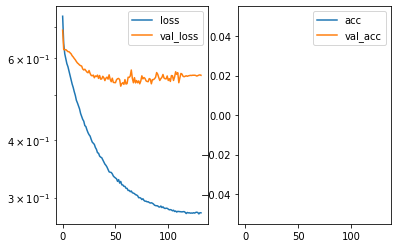

Predicted cell: Landmark Probability: [[0.9980762]]
True Cell type: Landmark
x [[0.66887325]]
True positional value x 0.421875
y [[0.39938632]]
True positional value y 0.578125


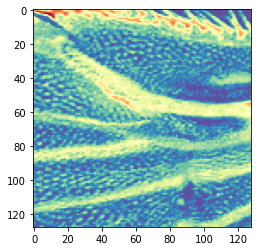

Epoch 133/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2786 - accuracy: 1.0000 - val_loss: 0.5506 - val_accuracy: 0.9143

Epoch 00133: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5505926949637276, 'val_accuracy': 0.9142857193946838, 'loss': 0.2785967901708132, 'accuracy': 1.0, 'lr': 1e-09}


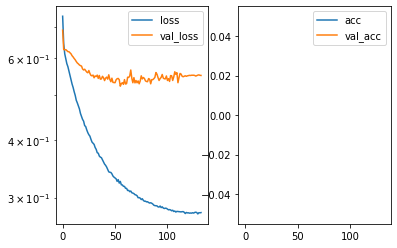

Predicted cell: Landmark Probability: [[0.99102825]]
True Cell type: Landmark
x [[0.6780719]]
True positional value x 0.578125
y [[0.154936]]
True positional value y 0.421875


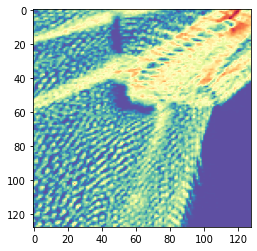

Epoch 134/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2785 - accuracy: 0.9992 - val_loss: 0.5509 - val_accuracy: 0.9143

Epoch 00134: ReduceLROnPlateau reducing learning rate to 9.999999717180686e-11.

Epoch 00134: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5509276453937803, 'val_accuracy': 0.9142857193946838, 'loss': 0.27851998689303914, 'accuracy': 0.999247, 'lr': 1e-09}


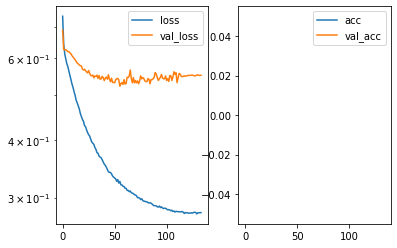

Predicted cell: Landmark Probability: [[0.97509354]]
True Cell type: Landmark
x [[0.45078215]]
True positional value x 0.421875
y [[0.6277898]]
True positional value y 0.5


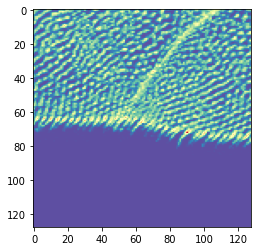

Epoch 135/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2795 - accuracy: 0.9981 - val_loss: 0.5502 - val_accuracy: 0.9143

Epoch 00135: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5502013542822429, 'val_accuracy': 0.9142857193946838, 'loss': 0.2795257946947612, 'accuracy': 0.99811745, 'lr': 9.9999994e-11}


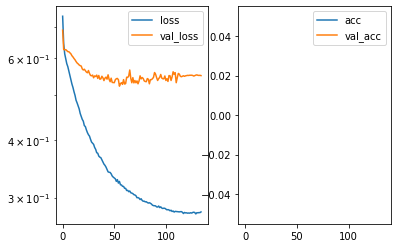

Predicted cell: Landmark Probability: [[0.97555214]]
True Cell type: Landmark
x [[0.45072824]]
True positional value x 0.421875
y [[0.6307089]]
True positional value y 0.5


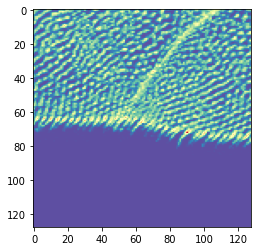

Epoch 136/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2782 - accuracy: 1.0000 - val_loss: 0.5498 - val_accuracy: 0.9143

Epoch 00136: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5497730651072094, 'val_accuracy': 0.9142857193946838, 'loss': 0.2782265626746847, 'accuracy': 1.0, 'lr': 9.9999994e-11}


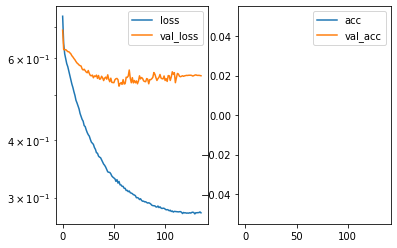

Predicted cell: Landmark Probability: [[0.9981529]]
True Cell type: Landmark
x [[0.7147878]]
True positional value x 0.578125
y [[0.48462144]]
True positional value y 0.578125


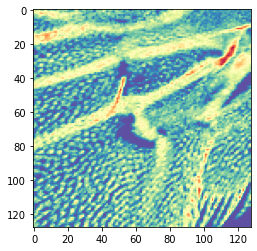

Epoch 137/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2776 - accuracy: 0.9996 - val_loss: 0.5508 - val_accuracy: 0.9143

Epoch 00137: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5507839151791164, 'val_accuracy': 0.9142857193946838, 'loss': 0.2776155174676194, 'accuracy': 0.9996235, 'lr': 9.9999994e-11}


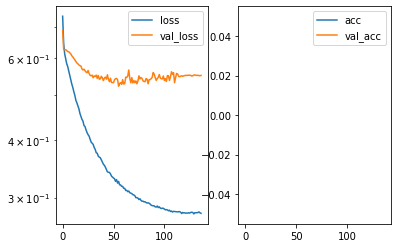

Predicted cell: Landmark Probability: [[0.99808717]]
True Cell type: Landmark
x [[0.6712998]]
True positional value x 0.421875
y [[0.39634234]]
True positional value y 0.578125


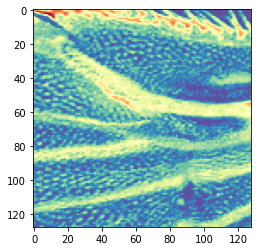

Epoch 138/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2777 - accuracy: 0.9996 - val_loss: 0.5502 - val_accuracy: 0.9143

Epoch 00138: ReduceLROnPlateau reducing learning rate to 9.99999943962493e-12.

Epoch 00138: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5501590562718255, 'val_accuracy': 0.9142857193946838, 'loss': 0.27774472848837634, 'accuracy': 0.9996235, 'lr': 9.9999994e-11}


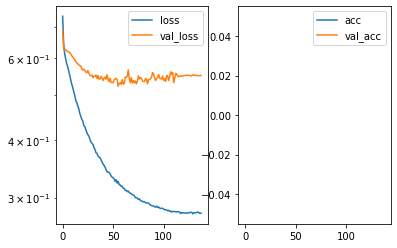

Predicted cell: Landmark Probability: [[0.99812394]]
True Cell type: Landmark
x [[0.7161426]]
True positional value x 0.578125
y [[0.48419613]]
True positional value y 0.578125


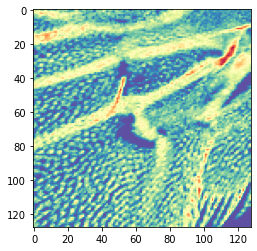

Epoch 139/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2774 - accuracy: 0.9996 - val_loss: 0.5512 - val_accuracy: 0.9143

Epoch 00139: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5511876174381801, 'val_accuracy': 0.9142857193946838, 'loss': 0.2774124660540417, 'accuracy': 0.9996235, 'lr': 9.999999e-12}


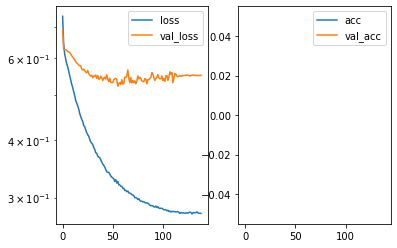

Predicted cell: Landmark Probability: [[0.99906045]]
True Cell type: Landmark
x [[0.3661388]]
True positional value x 0.578125
y [[0.6035993]]
True positional value y 0.421875


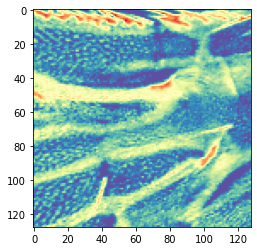

Epoch 140/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2776 - accuracy: 1.0000 - val_loss: 0.5505 - val_accuracy: 0.9071

Epoch 00140: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5505020767450333, 'val_accuracy': 0.9071428775787354, 'loss': 0.2775932034724448, 'accuracy': 1.0, 'lr': 9.999999e-12}


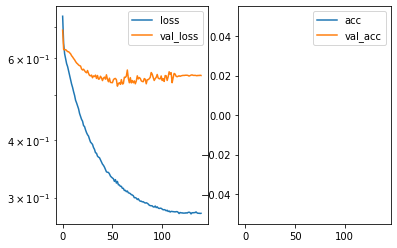

Predicted cell: Landmark Probability: [[0.9963534]]
True Cell type: Landmark
x [[0.44945964]]
True positional value x 0.5
y [[0.6364367]]
True positional value y 0.5


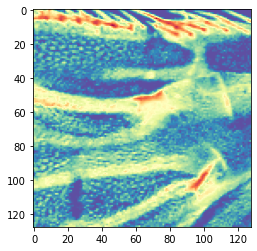

Epoch 141/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2781 - accuracy: 0.9996 - val_loss: 0.5501 - val_accuracy: 0.9143

Epoch 00141: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5500690639019012, 'val_accuracy': 0.9142857193946838, 'loss': 0.27813041219151163, 'accuracy': 0.9996235, 'lr': 9.999999e-12}


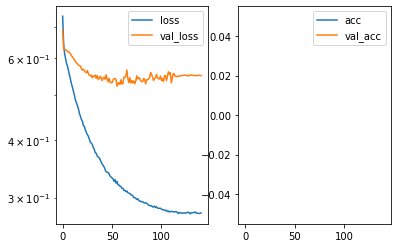

Predicted cell: Landmark Probability: [[0.9950612]]
True Cell type: Landmark
x [[0.52898234]]
True positional value x 0.421875
y [[0.28571293]]
True positional value y 0.5


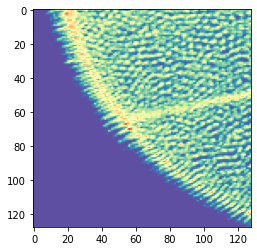

Epoch 142/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2793 - accuracy: 1.0000 - val_loss: 0.5503 - val_accuracy: 0.9143

Epoch 00142: ReduceLROnPlateau reducing learning rate to 9.999999092680235e-13.

Epoch 00142: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5502856033188956, 'val_accuracy': 0.9142857193946838, 'loss': 0.2792877014053155, 'accuracy': 1.0, 'lr': 9.999999e-12}


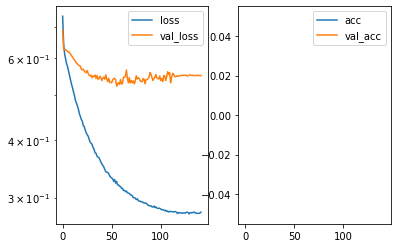

Predicted cell: Landmark Probability: [[0.9996693]]
True Cell type: Landmark
x [[0.36890054]]
True positional value x 0.5
y [[0.15881409]]
True positional value y 0.421875


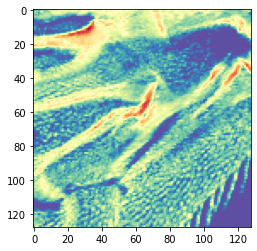

Epoch 143/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2780 - accuracy: 1.0000 - val_loss: 0.5510 - val_accuracy: 0.9143

Epoch 00143: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5509801826306752, 'val_accuracy': 0.9142857193946838, 'loss': 0.2779516636966223, 'accuracy': 1.0, 'lr': 9.999999e-13}


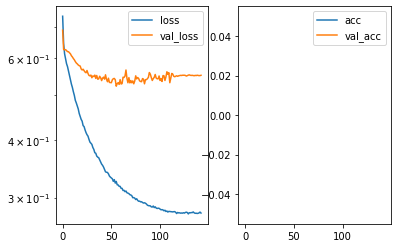

Predicted cell: Landmark Probability: [[0.95433235]]
True Cell type: Background
x [[0.38632917]]
True positional value x 0.5
y [[0.3288851]]
True positional value y 0.5


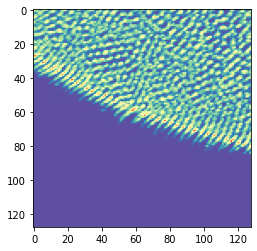

Epoch 144/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2789 - accuracy: 0.9992 - val_loss: 0.5509 - val_accuracy: 0.9143

Epoch 00144: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5508946137768882, 'val_accuracy': 0.9142857193946838, 'loss': 0.2788647892379976, 'accuracy': 0.999247, 'lr': 9.999999e-13}


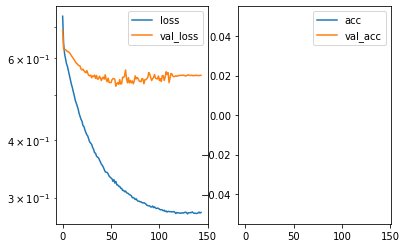

Predicted cell: Landmark Probability: [[0.9985274]]
True Cell type: Landmark
x [[0.5403735]]
True positional value x 0.421875
y [[0.56996715]]
True positional value y 0.578125


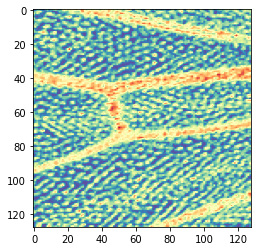

Epoch 145/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2798 - accuracy: 0.9989 - val_loss: 0.5509 - val_accuracy: 0.9143

Epoch 00145: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.550884627870151, 'val_accuracy': 0.9142857193946838, 'loss': 0.27979925517217225, 'accuracy': 0.9988705, 'lr': 9.999999e-13}


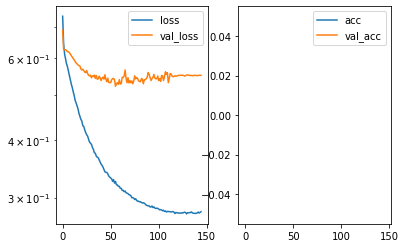

Predicted cell: Landmark Probability: [[0.998898]]
True Cell type: Landmark
x [[0.39073557]]
True positional value x 0.578125
y [[0.402907]]
True positional value y 0.421875


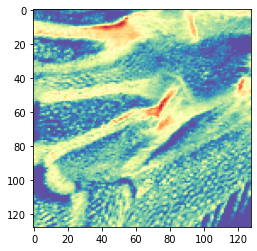

Epoch 146/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2785 - accuracy: 1.0000 - val_loss: 0.5496 - val_accuracy: 0.9143

Epoch 00146: ReduceLROnPlateau reducing learning rate to 9.9999988758398e-14.

Epoch 00146: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.549637747662408, 'val_accuracy': 0.9142857193946838, 'loss': 0.2784868296549981, 'accuracy': 1.0, 'lr': 9.999999e-13}


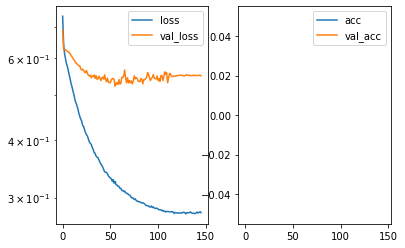

Predicted cell: Landmark Probability: [[0.99898225]]
True Cell type: Landmark
x [[0.39044735]]
True positional value x 0.421875
y [[0.362051]]
True positional value y 0.578125


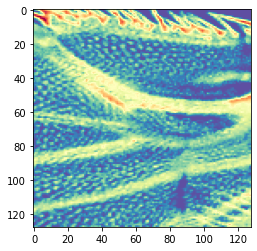

Epoch 147/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2795 - accuracy: 0.9992 - val_loss: 0.5508 - val_accuracy: 0.9143

Epoch 00147: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5507747594799314, 'val_accuracy': 0.9142857193946838, 'loss': 0.2795398174055729, 'accuracy': 0.999247, 'lr': 9.999999e-14}


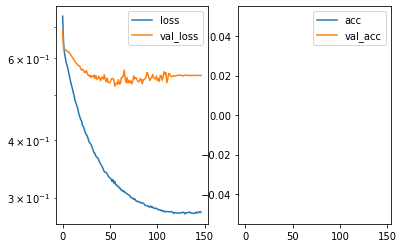

Predicted cell: Landmark Probability: [[0.9279766]]
True Cell type: Landmark
x [[0.3902862]]
True positional value x 0.5
y [[0.36294365]]
True positional value y 0.578125


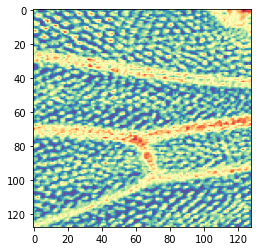

Epoch 148/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2778 - accuracy: 1.0000 - val_loss: 0.5510 - val_accuracy: 0.9143

Epoch 00148: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5510314000504357, 'val_accuracy': 0.9142857193946838, 'loss': 0.2777596990387124, 'accuracy': 1.0, 'lr': 9.999999e-14}


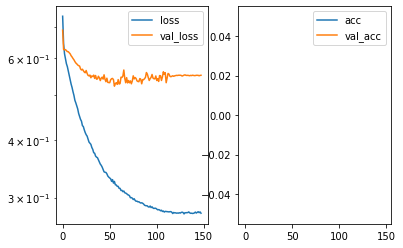

Predicted cell: Landmark Probability: [[0.9104984]]
True Cell type: Landmark
x [[0.2789106]]
True positional value x 0.421875
y [[0.18778898]]
True positional value y 0.578125


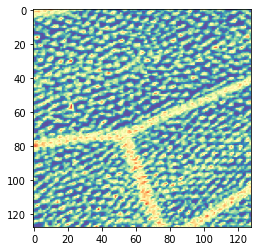

Epoch 149/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2781 - accuracy: 1.0000 - val_loss: 0.5513 - val_accuracy: 0.9071

Epoch 00149: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5513200227703366, 'val_accuracy': 0.9071428775787354, 'loss': 0.2780509616910334, 'accuracy': 1.0, 'lr': 9.999999e-14}


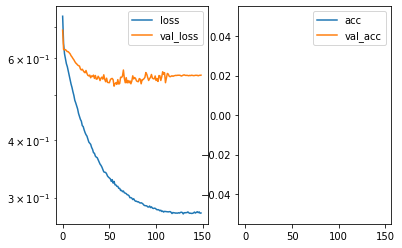

Predicted cell: Landmark Probability: [[0.99833435]]
True Cell type: Landmark
x [[0.75023407]]
True positional value x 0.5781249999999998
y [[0.7373899]]
True positional value y 0.421875


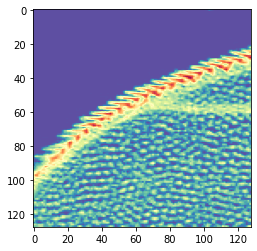

Epoch 150/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2785 - accuracy: 1.0000 - val_loss: 0.5495 - val_accuracy: 0.9143

Epoch 00150: ReduceLROnPlateau reducing learning rate to 9.999999146890344e-15.

Epoch 00150: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5494860623564038, 'val_accuracy': 0.9142857193946838, 'loss': 0.27851965352444047, 'accuracy': 1.0, 'lr': 9.999999e-14}


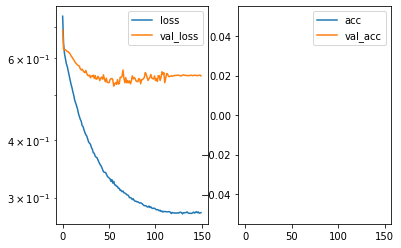

Predicted cell: Landmark Probability: [[0.9938339]]
True Cell type: Landmark
x [[0.68326986]]
True positional value x 0.578125
y [[0.39088538]]
True positional value y 0.421875


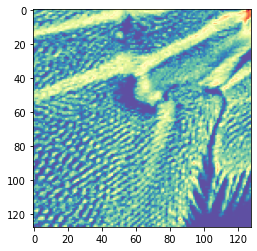

Epoch 151/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2781 - accuracy: 1.0000 - val_loss: 0.5504 - val_accuracy: 0.9143

Epoch 00151: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5504300934927804, 'val_accuracy': 0.9142857193946838, 'loss': 0.2780606888055083, 'accuracy': 1.0, 'lr': 9.999999e-15}


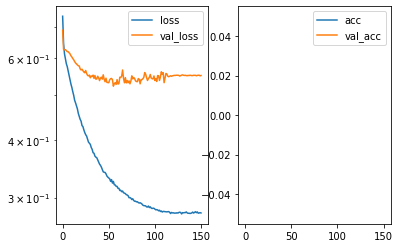

Predicted cell: Landmark Probability: [[0.9975089]]
True Cell type: Landmark
x [[0.48576513]]
True positional value x 0.421875
y [[0.39561328]]
True positional value y 0.5


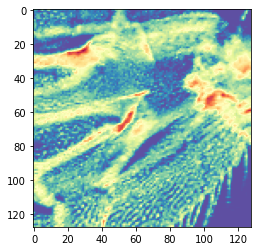

Epoch 152/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2780 - accuracy: 1.0000 - val_loss: 0.5515 - val_accuracy: 0.9143

Epoch 00152: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5515102424791881, 'val_accuracy': 0.9142857193946838, 'loss': 0.27795405405382795, 'accuracy': 1.0, 'lr': 9.999999e-15}


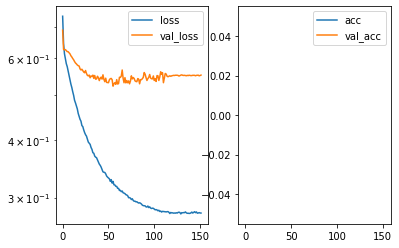

Predicted cell: Landmark Probability: [[0.926676]]
True Cell type: Landmark
x [[0.39013943]]
True positional value x 0.5
y [[0.36727566]]
True positional value y 0.578125


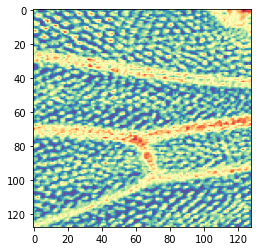

Epoch 153/250
2656/2656 [==============================] - 12s 5ms/step - loss: 0.2776 - accuracy: 0.9996 - val_loss: 0.5517 - val_accuracy: 0.9143

Epoch 00153: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5517167555434364, 'val_accuracy': 0.9142857193946838, 'loss': 0.2775646656841399, 'accuracy': 0.9996235, 'lr': 9.999999e-15}


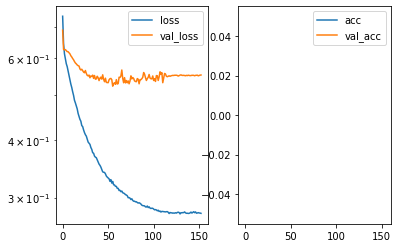

Predicted cell: Landmark Probability: [[0.979536]]
True Cell type: Landmark
x [[0.56615996]]
True positional value x 0.578125
y [[0.57021016]]
True positional value y 0.578125


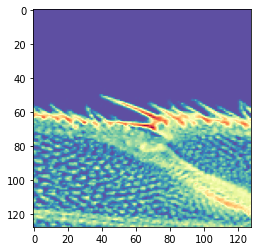

Epoch 154/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2787 - accuracy: 1.0000 - val_loss: 0.5508 - val_accuracy: 0.9143

Epoch 00154: ReduceLROnPlateau reducing learning rate to 9.999998977483753e-16.

Epoch 00154: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5507558350052152, 'val_accuracy': 0.9142857193946838, 'loss': 0.2786569046417633, 'accuracy': 1.0, 'lr': 9.999999e-15}


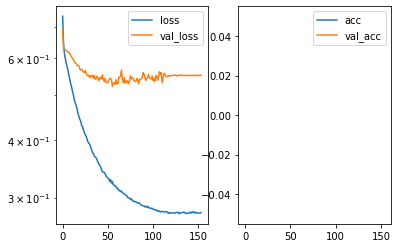

Predicted cell: Landmark Probability: [[0.96043944]]
True Cell type: Landmark
x [[0.46187118]]
True positional value x 0.578125
y [[0.61131805]]
True positional value y 0.421875


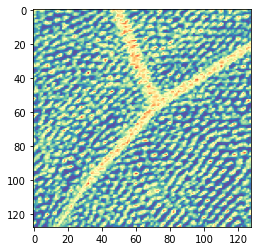

Epoch 155/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2777 - accuracy: 1.0000 - val_loss: 0.5509 - val_accuracy: 0.9143

Epoch 00155: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5509181427104133, 'val_accuracy': 0.9142857193946838, 'loss': 0.27767373935644885, 'accuracy': 1.0, 'lr': 9.999999e-16}


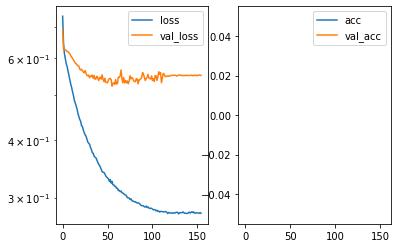

Predicted cell: Landmark Probability: [[0.998684]]
True Cell type: Landmark
x [[0.3778198]]
True positional value x 0.421875
y [[0.47738275]]
True positional value y 0.421875


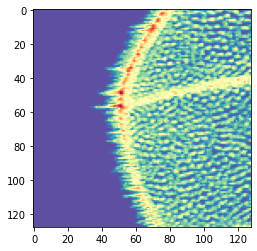

Epoch 156/250
2656/2656 [==============================] - 15s 6ms/step - loss: 0.2788 - accuracy: 1.0000 - val_loss: 0.5503 - val_accuracy: 0.9143

Epoch 00156: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5503368143524442, 'val_accuracy': 0.9142857193946838, 'loss': 0.27877999429243155, 'accuracy': 1.0, 'lr': 9.999999e-16}


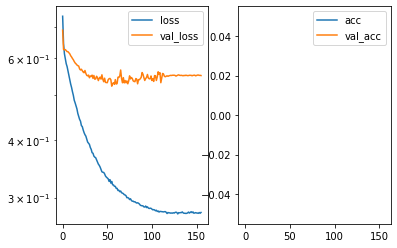

Predicted cell: Landmark Probability: [[0.9978916]]
True Cell type: Landmark
x [[0.3963705]]
True positional value x 0.5
y [[0.5264939]]
True positional value y 0.421875


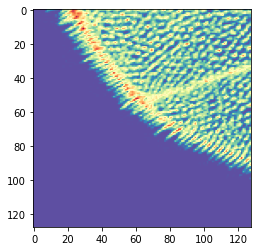

Epoch 157/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2788 - accuracy: 0.9992 - val_loss: 0.5511 - val_accuracy: 0.9143

Epoch 00157: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.551091228212629, 'val_accuracy': 0.9142857193946838, 'loss': 0.2787841120173773, 'accuracy': 0.999247, 'lr': 9.999999e-16}


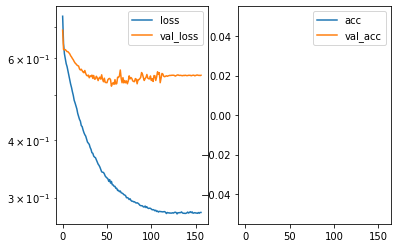

Predicted cell: Landmark Probability: [[0.9307752]]
True Cell type: Background
x [[0.5014263]]
True positional value x 0.5
y [[0.37259609]]
True positional value y 0.5


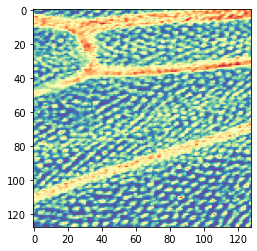

Epoch 158/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2791 - accuracy: 0.9989 - val_loss: 0.5507 - val_accuracy: 0.9143

Epoch 00158: ReduceLROnPlateau reducing learning rate to 9.999998977483754e-17.

Epoch 00158: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5506633243390492, 'val_accuracy': 0.9142857193946838, 'loss': 0.279064471463123, 'accuracy': 0.9988705, 'lr': 9.999999e-16}


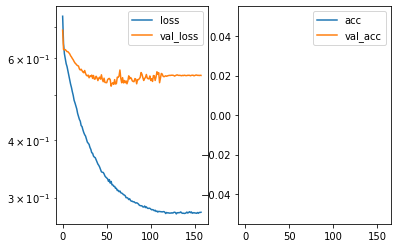

Predicted cell: Landmark Probability: [[0.997951]]
True Cell type: Landmark
x [[0.49320313]]
True positional value x 0.5781249999999999
y [[0.64126414]]
True positional value y 0.578125


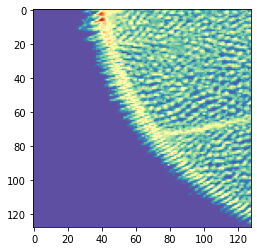

Epoch 159/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2775 - accuracy: 0.9992 - val_loss: 0.5509 - val_accuracy: 0.9143

Epoch 00159: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5509466316018786, 'val_accuracy': 0.9142857193946838, 'loss': 0.27752442891339224, 'accuracy': 0.999247, 'lr': 9.999999e-17}


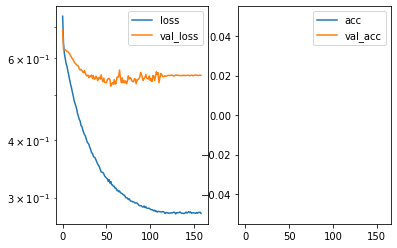

Predicted cell: Landmark Probability: [[0.99281573]]
True Cell type: Landmark
x [[0.5243387]]
True positional value x 0.5
y [[0.6026432]]
True positional value y 0.578125


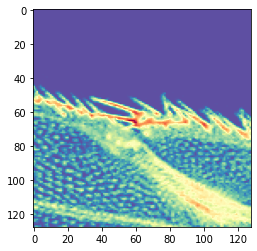

Epoch 160/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2786 - accuracy: 0.9996 - val_loss: 0.5506 - val_accuracy: 0.9143

Epoch 00160: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5506152127470288, 'val_accuracy': 0.9142857193946838, 'loss': 0.2786083817033164, 'accuracy': 0.9996235, 'lr': 9.999999e-17}


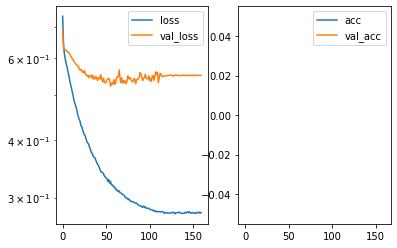

Predicted cell: Landmark Probability: [[0.99289274]]
True Cell type: Landmark
x [[0.78669965]]
True positional value x 0.5
y [[0.44282886]]
True positional value y 0.578125


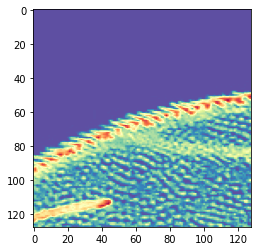

Epoch 161/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2781 - accuracy: 0.9992 - val_loss: 0.5507 - val_accuracy: 0.9143

Epoch 00161: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5507107951811382, 'val_accuracy': 0.9142857193946838, 'loss': 0.2780934064817357, 'accuracy': 0.999247, 'lr': 9.999999e-17}


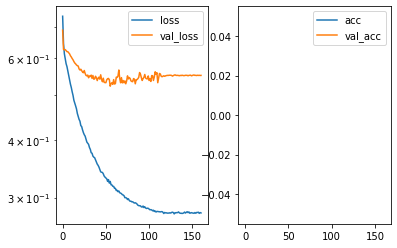

Predicted cell: Landmark Probability: [[0.99559116]]
True Cell type: Landmark
x [[0.82890886]]
True positional value x 0.578125
y [[0.3867768]]
True positional value y 0.421875


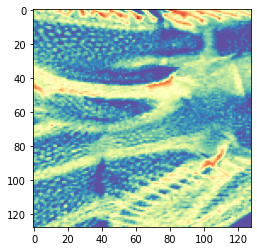

Epoch 162/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2789 - accuracy: 0.9992 - val_loss: 0.5501 - val_accuracy: 0.9143

Epoch 00162: ReduceLROnPlateau reducing learning rate to 9.999998845134856e-18.

Epoch 00162: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.550091102719307, 'val_accuracy': 0.9142857193946838, 'loss': 0.2788870334849659, 'accuracy': 0.999247, 'lr': 9.999999e-17}


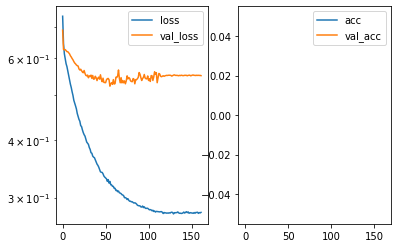

Predicted cell: Landmark Probability: [[0.97418743]]
True Cell type: Landmark
x [[0.4981173]]
True positional value x 0.578125
y [[0.48492214]]
True positional value y 0.578125


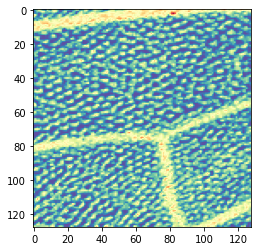

Epoch 163/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2780 - accuracy: 0.9996 - val_loss: 0.5509 - val_accuracy: 0.9143

Epoch 00163: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5509271451405117, 'val_accuracy': 0.9142857193946838, 'loss': 0.27801479744803476, 'accuracy': 0.9996235, 'lr': 9.999999e-18}


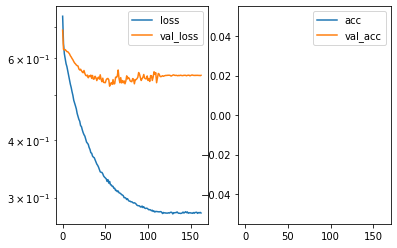

Predicted cell: Landmark Probability: [[0.9849044]]
True Cell type: Landmark
x [[0.6514047]]
True positional value x 0.578125
y [[0.40768173]]
True positional value y 0.421875


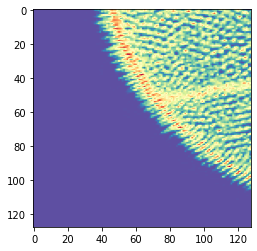

Epoch 164/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2792 - accuracy: 0.9989 - val_loss: 0.5518 - val_accuracy: 0.9143

Epoch 00164: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5518054557698113, 'val_accuracy': 0.9142857193946838, 'loss': 0.27920616923057173, 'accuracy': 0.9988705, 'lr': 9.999999e-18}


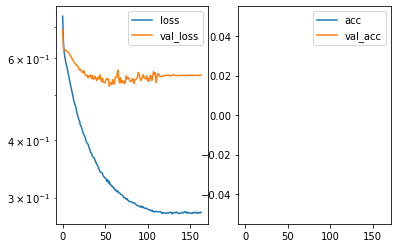

Predicted cell: Landmark Probability: [[0.99795353]]
True Cell type: Landmark
x [[0.5008495]]
True positional value x 0.5781249999999999
y [[0.63422817]]
True positional value y 0.578125


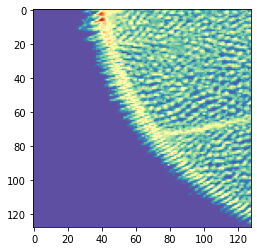

Epoch 165/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2782 - accuracy: 0.9996 - val_loss: 0.5509 - val_accuracy: 0.9071

Epoch 00165: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5509244097130639, 'val_accuracy': 0.9071428775787354, 'loss': 0.27820085287542945, 'accuracy': 0.9996235, 'lr': 9.999999e-18}


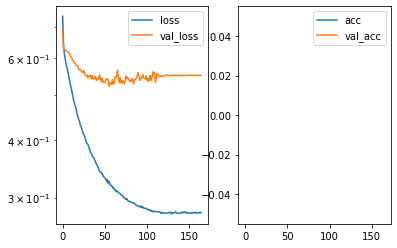

Predicted cell: Landmark Probability: [[0.9963152]]
True Cell type: Landmark
x [[0.61384284]]
True positional value x 0.5
y [[0.6517183]]
True positional value y 0.578125


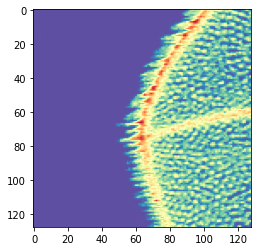

Epoch 166/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2780 - accuracy: 1.0000 - val_loss: 0.5503 - val_accuracy: 0.9071

Epoch 00166: ReduceLROnPlateau reducing learning rate to 9.999999010570977e-19.

Epoch 00166: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5502658443791526, 'val_accuracy': 0.9071428775787354, 'loss': 0.277960291356746, 'accuracy': 1.0, 'lr': 9.999999e-18}


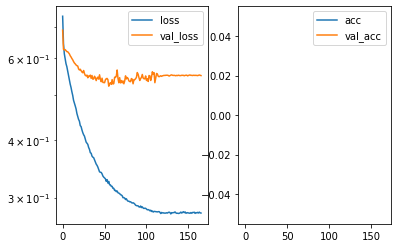

Predicted cell: Landmark Probability: [[0.8760038]]
True Cell type: Background
x [[0.5974912]]
True positional value x 0.5
y [[0.6408518]]
True positional value y 0.5


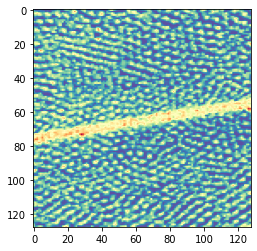

Epoch 167/250
2656/2656 [==============================] - 12s 4ms/step - loss: 0.2781 - accuracy: 1.0000 - val_loss: 0.5508 - val_accuracy: 0.9143

Epoch 00167: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5508213511535099, 'val_accuracy': 0.9142857193946838, 'loss': 0.27811487723725387, 'accuracy': 1.0, 'lr': 9.999999e-19}


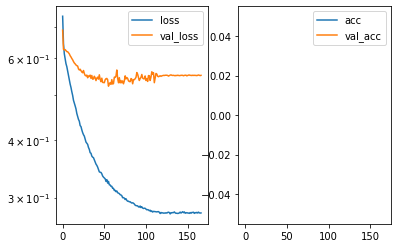

Predicted cell: Landmark Probability: [[0.99852604]]
True Cell type: Landmark
x [[0.5336118]]
True positional value x 0.421875
y [[0.5715883]]
True positional value y 0.578125


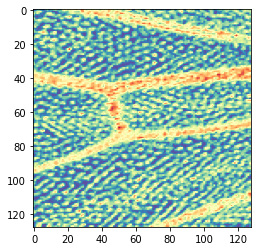

Epoch 168/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2787 - accuracy: 1.0000 - val_loss: 0.5506 - val_accuracy: 0.9143

Epoch 00168: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5506138269390378, 'val_accuracy': 0.9142857193946838, 'loss': 0.278664138055889, 'accuracy': 1.0, 'lr': 9.999999e-19}


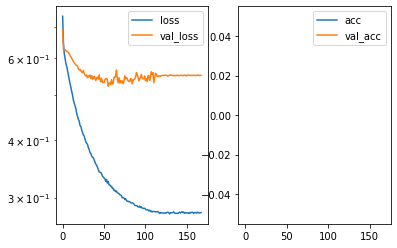

Predicted cell: Landmark Probability: [[0.9951874]]
True Cell type: Landmark
x [[0.52974683]]
True positional value x 0.421875
y [[0.28309485]]
True positional value y 0.5


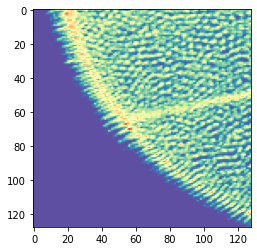

Epoch 169/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2783 - accuracy: 0.9992 - val_loss: 0.5513 - val_accuracy: 0.9071

Epoch 00169: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5512567439249584, 'val_accuracy': 0.9071428775787354, 'loss': 0.27829077819654024, 'accuracy': 0.999247, 'lr': 9.999999e-19}


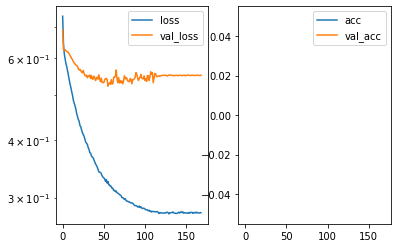

Predicted cell: Landmark Probability: [[0.9852266]]
True Cell type: Landmark
x [[0.6505956]]
True positional value x 0.578125
y [[0.40994662]]
True positional value y 0.421875


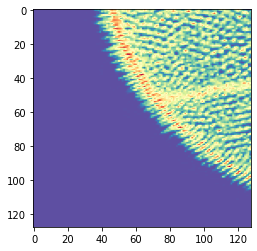

Epoch 170/250
2656/2656 [==============================] - 11s 4ms/step - loss: 0.2782 - accuracy: 0.9996 - val_loss: 0.5505 - val_accuracy: 0.9143

Epoch 00170: ReduceLROnPlateau reducing learning rate to 9.999999424161285e-20.

Epoch 00170: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5505004099437169, 'val_accuracy': 0.9142857193946838, 'loss': 0.2781691851924701, 'accuracy': 0.9996235, 'lr': 9.999999e-19}


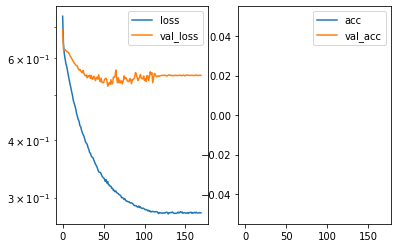

Predicted cell: Landmark Probability: [[0.9999385]]
True Cell type: Landmark
x [[0.46365404]]
True positional value x 0.578125
y [[0.5595792]]
True positional value y 0.5


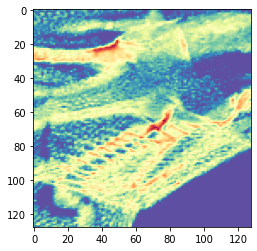

Epoch 171/250
2656/2656 [==============================] - 12s 5ms/step - loss: 0.2781 - accuracy: 0.9992 - val_loss: 0.5497 - val_accuracy: 0.9143

Epoch 00171: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5496572064501899, 'val_accuracy': 0.9142857193946838, 'loss': 0.2781000207346606, 'accuracy': 0.999247, 'lr': 1e-19}


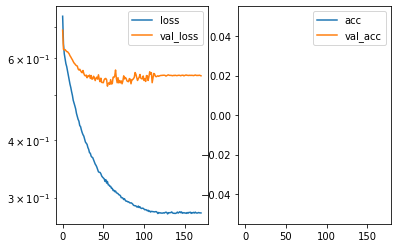

Predicted cell: Landmark Probability: [[0.97083867]]
True Cell type: Landmark
x [[0.4595596]]
True positional value x 0.5
y [[0.69214195]]
True positional value y 0.578125


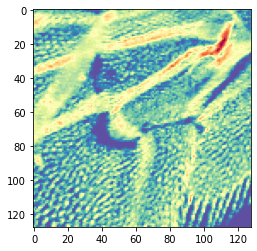

Epoch 172/250
2656/2656 [==============================] - 10s 4ms/step - loss: 0.2792 - accuracy: 0.9996 - val_loss: 0.5513 - val_accuracy: 0.9143

Epoch 00172: saving model to /home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/Landmark/Landmark128.h5
{'val_loss': 0.5513036868401936, 'val_accuracy': 0.9142857193946838, 'loss': 0.2791736486132245, 'accuracy': 0.9996235, 'lr': 1e-19}


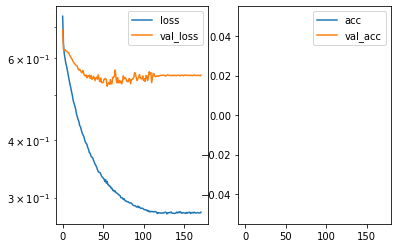

Predicted cell: Landmark Probability: [[0.99454665]]
True Cell type: Landmark
x [[0.9003361]]
True positional value x 0.578125
y [[0.69296587]]
True positional value y 0.578125


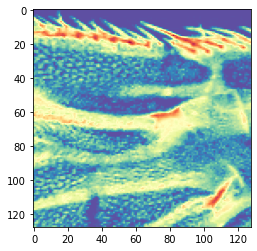

Epoch 173/250
 800/2656 [========>.....................] - ETA: 7s - loss: 0.2784 - accuracy: 1.0000

KeyboardInterrupt: 

In [5]:
static_model = NEATStatic(config, model_dir, model_name)

static_model.loadData()

static_model.TrainModel()
